---
## Package Imports
---

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
!pip install plotly --upgrade
!pip install sweetviz
!pip install langdetect
!pip install mlxtend
!pip install umap-learn
!pip install tensorboardX
!pip install transformers

In [ ]:
import numpy as np
import pandas as pd
import csv
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import math
import random
import time
import re
import itertools
import statistics
from collections import Counter
import sklearn
from sklearn.preprocessing import MultiLabelBinarizer
import multiprocessing
from multiprocessing import Pool
import datetime
import scipy
import plotly.express as px
import plotly
import plotly.figure_factory as ff
import plotly.graph_objects as go
print(plotly.__version__)
import sweetviz as sv

from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import umap.umap_ as umap

from langdetect import detect

from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
import networkx as nx

import pickle

from gensim.models.doc2vec import Doc2Vec, TaggedDocument

from sklearn.manifold import TSNE
from tensorboardX import SummaryWriter
import torch

# NLTK and stopwords
import nltk
from nltk.corpus import stopwords
from nltk import word_tokenize, sent_tokenize, pos_tag
from nltk.util import ngrams
from nltk.stem import WordNetLemmatizer

import gensim
from gensim import corpora, models
from gensim.models import Word2Vec
import gensim.downloader as api

# Vectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics import pairwise_distances

nltk.download('averaged_perceptron_tagger')
nltk.download("wordnet")
nltk.download("punkt")
nltk.download("stopwords")
stop_words = set(stopwords.words("english"))

# Supervised part
import sklearn
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import SelectFromModel

# MLP with PyTorch
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torch.autograd import Variable
# check pytorch version
print(torch.__version__)

# Settings
BATCH_SIZE = 16
pd.set_option("max_columns", 200)
CPU_COUNT = multiprocessing.cpu_count() # CPU count
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


5.3.1
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
1.9.0+cu102
cpu


---
## Preprocessing
---

In [ ]:
# Load data
df_titles = pd.read_csv("drive/MyDrive/694_Milestone II/titles_5000.csv")
df_reviews = pd.read_csv("drive/MyDrive/694_Milestone II/reviews_5000.csv")
df_tags = pd.read_csv("drive/MyDrive/694_Milestone II/tags_5000.csv")

# Preprocess genre column: convert from string to array
df_titles["genres"] = df_titles["genres"].apply(lambda x: re.findall("'(.*?)'", x))

# Convert genre columns to OHE-like columns
mlb = MultiLabelBinarizer()
df_titles = df_titles.join(pd.DataFrame(mlb.fit_transform(df_titles["genres"]),columns=mlb.classes_))
df_titles = df_titles.drop("genres", axis=1)

# For titles table, make sure there are no overlap for the titles
# Sweetviz allowed us to detect these
dup_df_native = df_titles.groupby("title_native").filter(lambda x: len(x) > 1).sort_values("title_native")
dup_df_romaji = df_titles.groupby("title_romaji").filter(lambda x: len(x) > 1).sort_values("title_romaji")
dup_df_synopsis = df_titles.groupby("synopsis").filter(lambda x: len(x) > 1).sort_values("synopsis")

# There seems to be an overlap in titles. Drop both as there are only 40 records in total, out of 1000
print("before cleaning duplicate rows: ", len(df_titles))
dup_title_ids_native = dup_df_native["title_id"].values
dup_title_ids_romaji = dup_df_romaji["title_id"].values
dup_title_ids_synopsis = dup_df_synopsis["synopsis"].values
df_titles = df_titles[~df_titles["title_id"].isin(dup_title_ids_native)]
df_titles = df_titles[~df_titles["title_id"].isin(dup_title_ids_romaji)]
df_titles = df_titles[~df_titles["synopsis"].isin(dup_title_ids_synopsis)]
print("after cleaning duplicate rows: ", len(df_titles))

# Check title_ids in reviews and tags are all contained in titles table
title_ids = df_titles["title_id"].unique()
rev_title_ids = df_reviews["title_id"].unique()
tag_title_ids = df_tags["title_id"].unique()
print(sum(np.isin(rev_title_ids, title_ids)) == len(rev_title_ids))
print(sum(np.isin(tag_title_ids, title_ids)) == len(tag_title_ids))

# Filter reviews and tags table only to those that are in titles table
print("before reviews table cleaning: ", len(df_reviews))
print("before tags table cleaning: ", len(df_tags))
df_reviews = df_reviews[df_reviews["title_id"].isin(title_ids)]
df_tags = df_tags[df_tags["title_id"].isin(title_ids)]
print("after reviews table cleaning: ", len(df_reviews))
print("after tags table cleaning: ", len(df_tags))

# Add a column that adds the review count
df_review_count = df_reviews.groupby("title_id").size()
df_review_count = df_review_count.reset_index().rename(columns={0: "review_count"})
df_titles = pd.merge(df_titles, df_review_count, how="outer", on="title_id")

# Add a column that adds the tags count
df_tags_count = df_tags.groupby("title_id").size()
df_tags_count = df_tags_count.reset_index().rename(columns={0: "tags_count"})
df_titles = pd.merge(df_titles, df_tags_count, how="outer", on="title_id")

# Drop meaningless columns in reviews and tags
df_reviews = df_reviews.drop(columns=["Unnamed: 0"], axis=1)
df_tags = df_tags.drop(columns=["Unnamed: 0"], axis=1)

# Check what language the review is written in (filter out non-English ones if it doesn't occupy large percentage)
df_reviews["lang"] = df_reviews["text_summary"].apply(lambda x: detect(x))
# print(df_reviews["lang"].value_counts()) # it's a bit of a pain to lose ~10% of review data but filter out non-English reviews to simplify the problem
df_reviews = df_reviews[df_reviews["lang"] == "en"]
print("reviews table count after filtering out non-English reviews: ", len(df_reviews))

# Check len (should be 956)
print(len(df_titles))
display(df_titles.head())

before cleaning duplicate rows:  5000
after cleaning duplicate rows:  4667
False
False
before reviews table cleaning:  1290
before tags table cleaning:  29994
after reviews table cleaning:  1198
after tags table cleaning:  27625
reviews table count after filtering out non-English reviews:  1084
4667


,title_id,title_native,title_romaji,start_year,chapters,volume,publishing_status,country,adult,average_score,mean_score,popularity,favorites,score_10,score_20,score_30,score_40,score_50,score_60,score_70,score_80,score_90,score_100,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,ranking_RATED,ranking_POPULAR,synopsis,cover_image_url,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count
0,30002,ベルセルク,Berserk,1989.0,NaN,NaN,RELEASING,JP,False,92,92,86848,15709,458.0,25.0,50.0,77.0,157.0,282.0,872,2378,7428,18605,41061,28339,7584,1300,8564,1.0,7.0,"His name is Guts, the Black Swordsman, a feare...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,10.0,36.0
1,30013,ONE PIECE,ONE PIECE,1997.0,NaN,NaN,RELEASING,JP,False,91,91,83201,17391,239.0,41.0,69.0,140.0,337.0,620.0,1730,3798,9344,20963,57479,12759,3088,2567,7308,1.0,1.0,"As a child, Monkey D. Luffy was inspired to be...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,11.0,54.0
2,31706,ジョジョの奇妙な冒険 スティール・ボール・ラン,JoJo no Kimyou na Bouken: Steel Ball Run,2004.0,95.0,24.0,FINISHED,JP,False,91,91,40754,8341,375.0,9.0,18.0,41.0,74.0,177.0,632,1651,5591,11017,4899,11582,22916,265,1092,1.0,1.0,"Originally presented as an unrelated story, th...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,5.0,20.0
3,30656,バガボンド,Vagabond,1999.0,NaN,NaN,RELEASING,JP,False,90,90,49289,6265,230.0,5.0,16.0,26.0,86.0,153.0,479,1385,3884,6961,13310,24352,6589,514,4524,1.0,1.0,"At seventeen years of age, Miyamoto Musashi--s...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8.0,20.0
4,30001,MONSTER,MONSTER,1994.0,162.0,18.0,FINISHED,JP,False,90,90,38251,4010,144.0,5.0,18.0,30.0,79.0,128.0,424,1146,3337,5410,4210,20159,12143,304,1435,1.0,1.0,Everyone faces uncertainty at some point in th...,{'large': 'https://s4.anilist.co/file/anilistc...,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,5.0,16.0


---
## EDA
---

### Feature Distribution of titles, reviews, tags table

,title_id,title_native,title_romaji,start_year,chapters,volume,publishing_status,country,adult,average_score,mean_score,popularity,favorites,score_10,score_20,score_30,score_40,score_50,score_60,score_70,score_80,score_90,score_100,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,ranking_RATED,ranking_POPULAR,synopsis,cover_image_url,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count
0,30002,ベルセルク,Berserk,1989.0,NaN,NaN,RELEASING,JP,False,92,92,86848,15709,458.0,25.0,50.0,77.0,157.0,282.0,872,2378,7428,18605,41061,28339,7584,1300,8564,1.0,7.0,"His name is Guts, the Black Swordsman, a feare...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,10.0,36.0
1,30013,ONE PIECE,ONE PIECE,1997.0,NaN,NaN,RELEASING,JP,False,91,91,83201,17391,239.0,41.0,69.0,140.0,337.0,620.0,1730,3798,9344,20963,57479,12759,3088,2567,7308,1.0,1.0,"As a child, Monkey D. Luffy was inspired to be...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,11.0,54.0
2,31706,ジョジョの奇妙な冒険 スティール・ボール・ラン,JoJo no Kimyou na Bouken: Steel Ball Run,2004.0,95.0,24.0,FINISHED,JP,False,91,91,40754,8341,375.0,9.0,18.0,41.0,74.0,177.0,632,1651,5591,11017,4899,11582,22916,265,1092,1.0,1.0,"Originally presented as an unrelated story, th...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,5.0,20.0
3,30656,バガボンド,Vagabond,1999.0,NaN,NaN,RELEASING,JP,False,90,90,49289,6265,230.0,5.0,16.0,26.0,86.0,153.0,479,1385,3884,6961,13310,24352,6589,514,4524,1.0,1.0,"At seventeen years of age, Miyamoto Musashi--s...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8.0,20.0
4,30001,MONSTER,MONSTER,1994.0,162.0,18.0,FINISHED,JP,False,90,90,38251,4010,144.0,5.0,18.0,30.0,79.0,128.0,424,1146,3337,5410,4210,20159,12143,304,1435,1.0,1.0,Everyone faces uncertainty at some point in th...,{'large': 'https://s4.anilist.co/file/anilistc...,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,5.0,16.0


                                             |          | [  0%]   00:00 -> (? left)

Report eda_titles.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



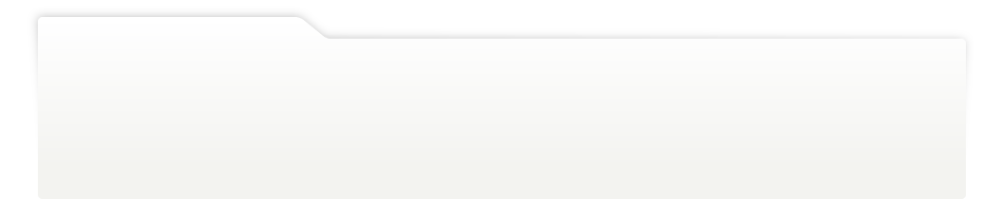
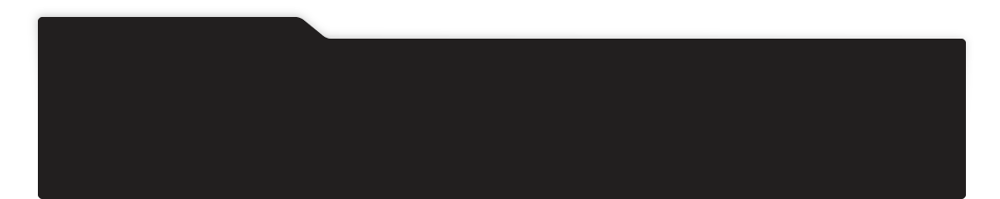
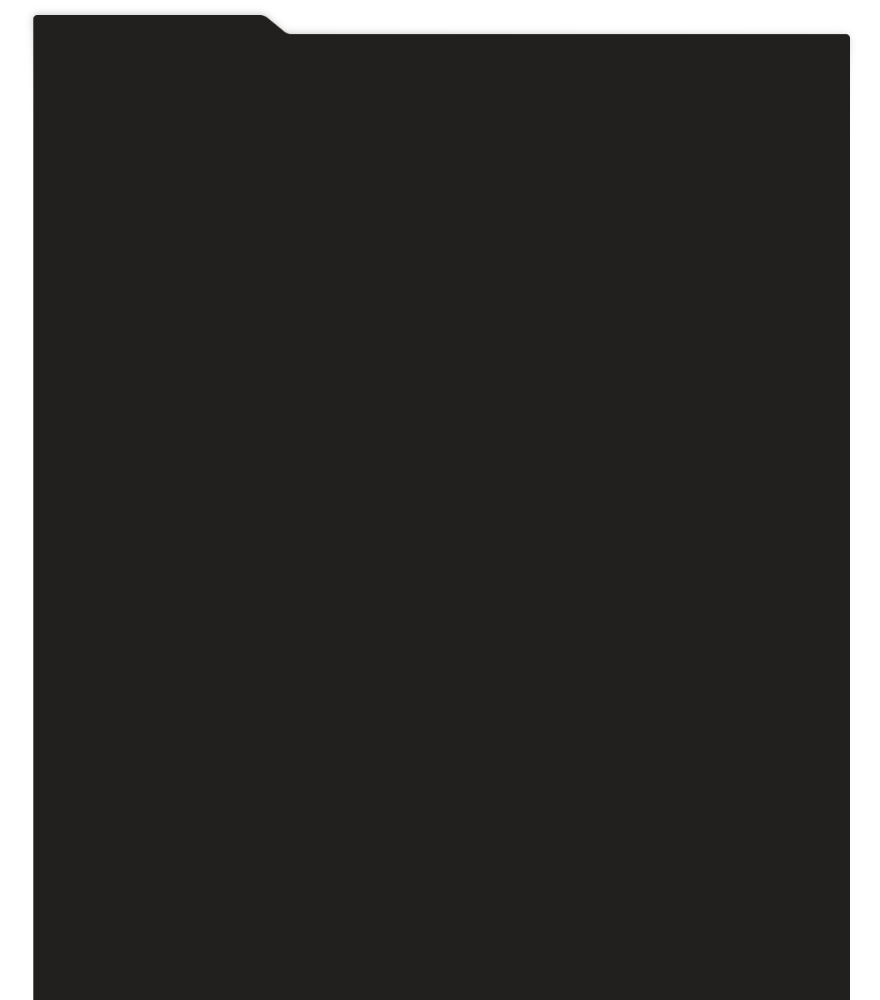
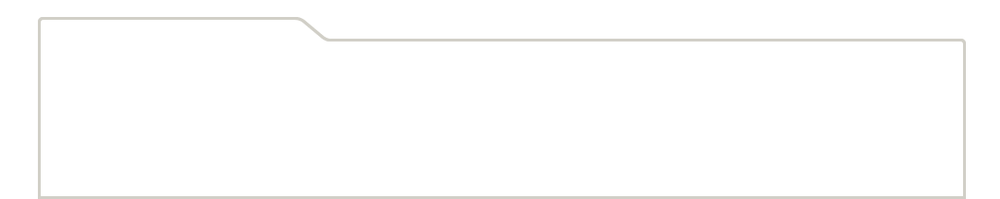
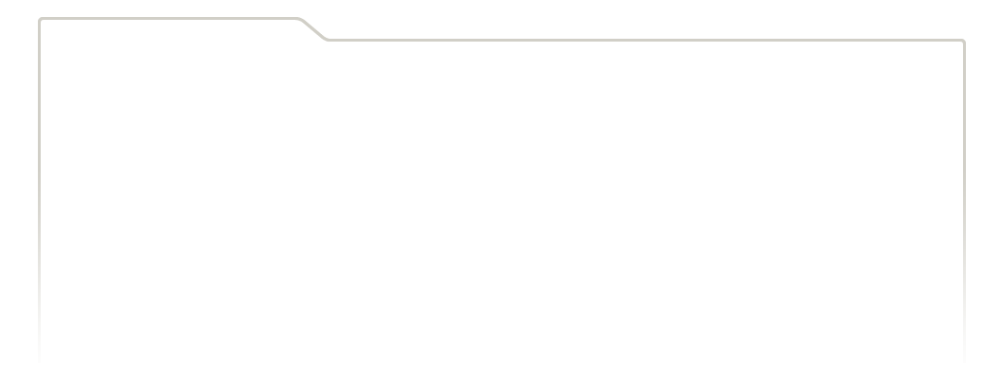
...
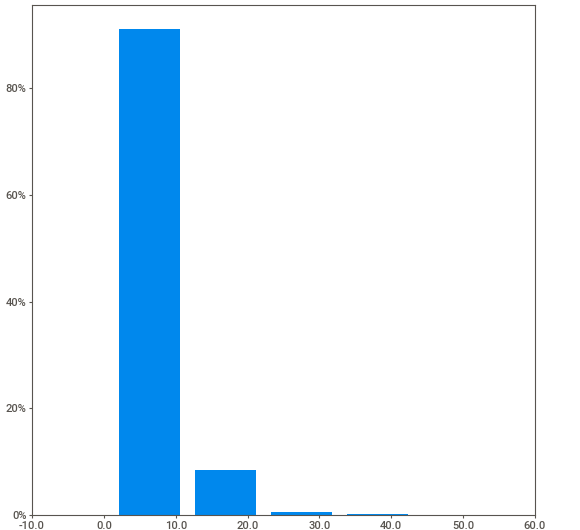
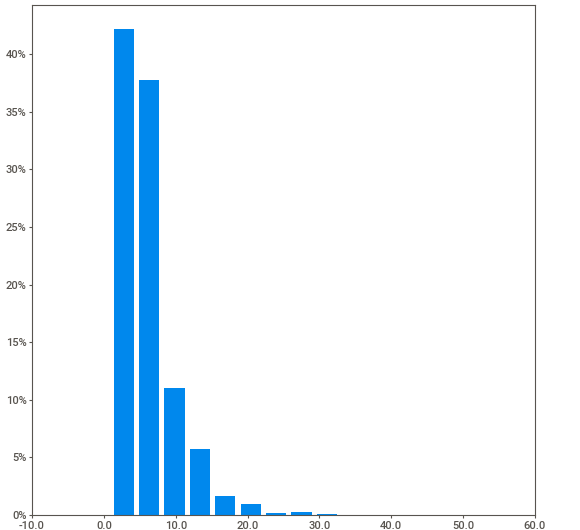
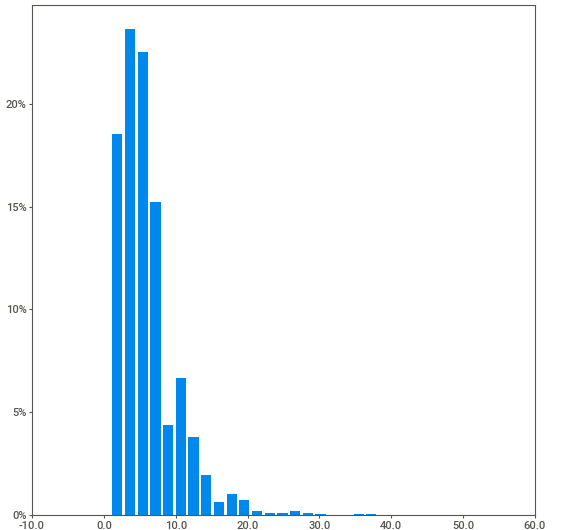
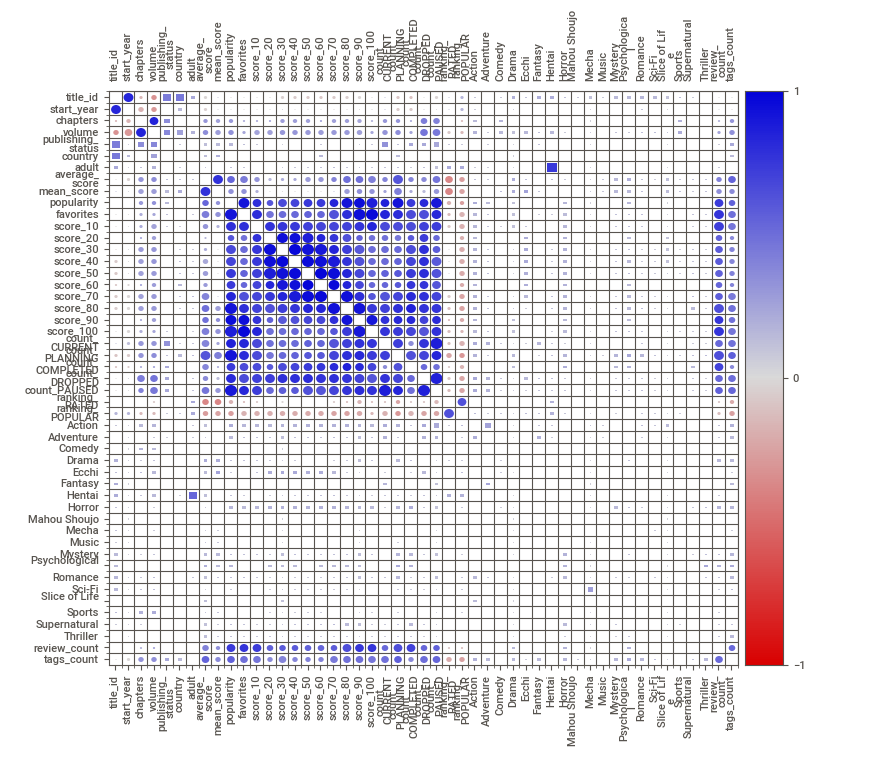
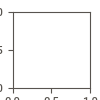

In [ ]:
# Quick EDA using sweetviz: titles table
display(df_titles.head())
report=sv.analyze(df_titles)
report.show_html("eda_titles.html")
report.show_notebook(w=None, h=None, scale=None, layout="vertical")

,review_id,title_id,title_native,title_romaji,user_id,user_name,score,rating,ratingCount,text_summary,text_body,lang
0,2791,30002,ベルセルク,Berserk,127937,DimsTheImmortal,85,23,52,This would be the first time i try tackling a ...,"Alrightee alrightee alrightee, here is my bers...",en
1,3811,30002,ベルセルク,Berserk,118781,myvelouria,100,152,167,One person's thoughts on one man's masterpiece.,This review contains spoilers.\n\nWhen one thi...,en
3,11421,30002,ベルセルク,Berserk,403142,c4e,100,316,337,A Timeless and Peerless Masterpiece - The Grea...,# ~~~___A Timeless and Peerless Masterpiece - ...,en
5,11781,30002,ベルセルク,Berserk,63817,TheGrumblingGoblin,100,81,87,This wasn't how any of us wanted it to go. Nev...,~~~img(https://i.imgur.com/2jXWSu7.png)~~~\n\n...,en
6,12405,30002,ベルセルク,Berserk,5435290,P3PO,60,12,119,"Short {RECORDBREAKING, TURBOHYPE, GIGACHAD} Go...",I will try be as short as possible. Feel free ...,en


                                             |          | [  0%]   00:00 -> (? left)

Report eda_reviews.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



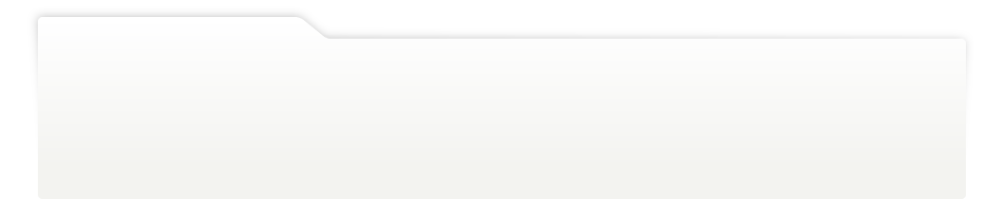
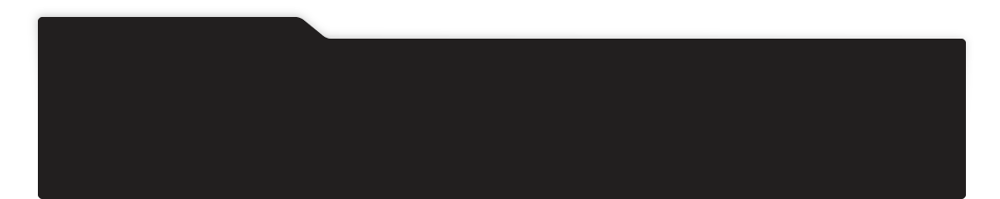
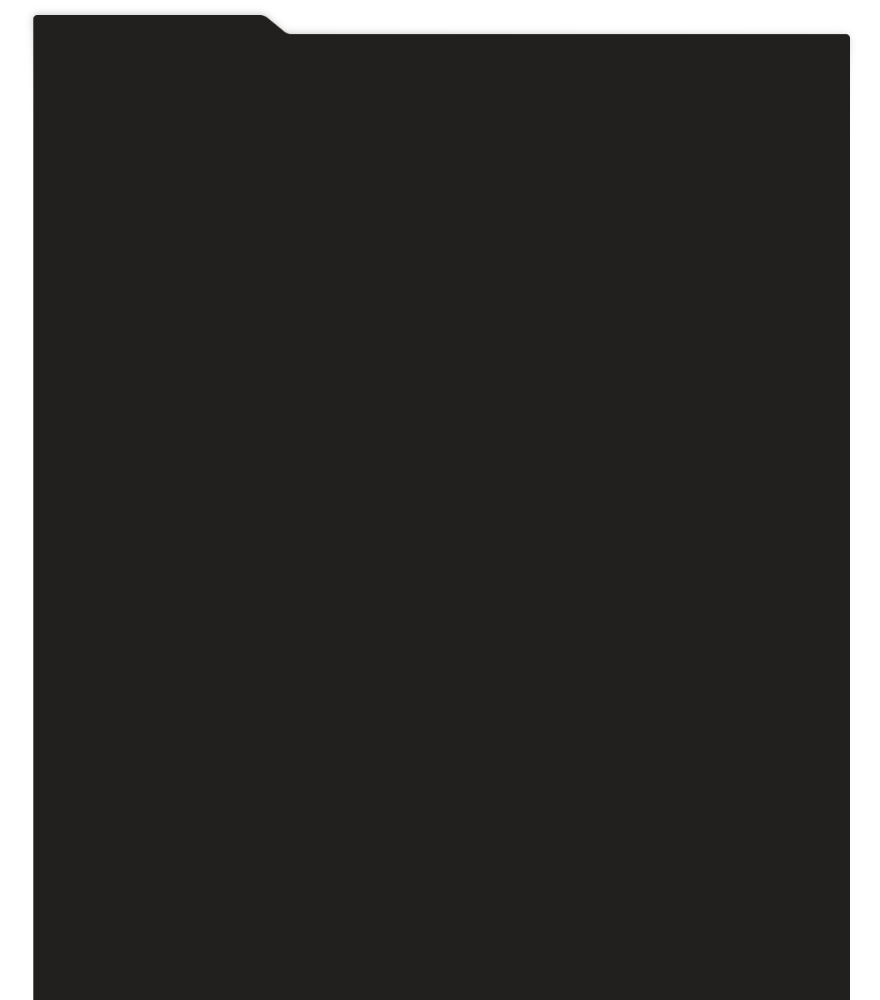
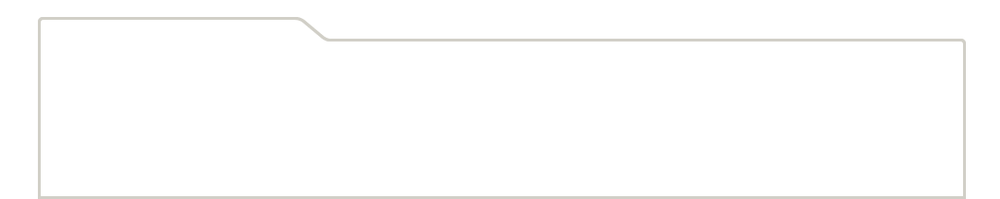
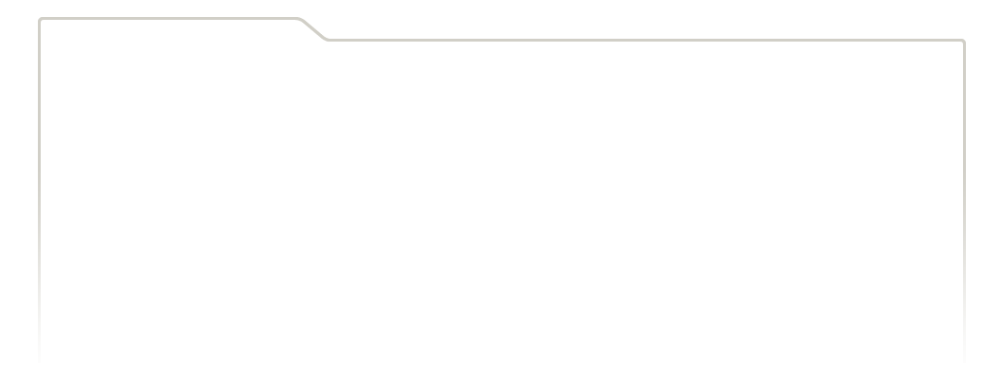
...
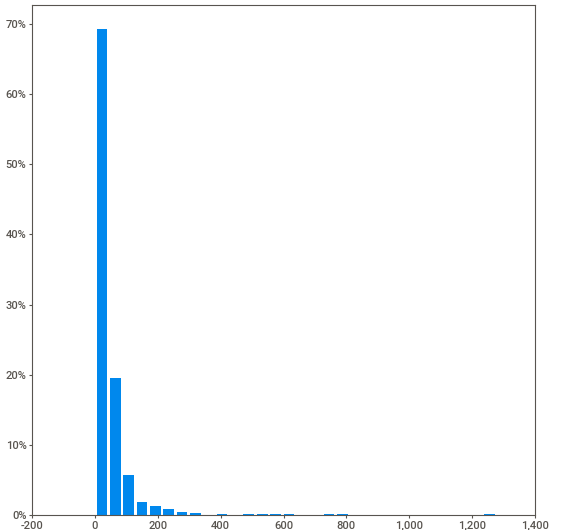
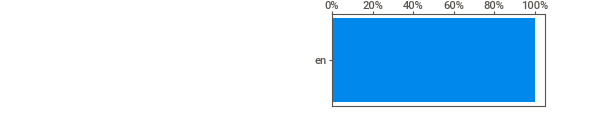
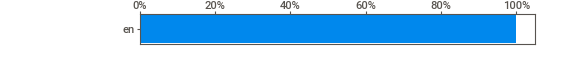
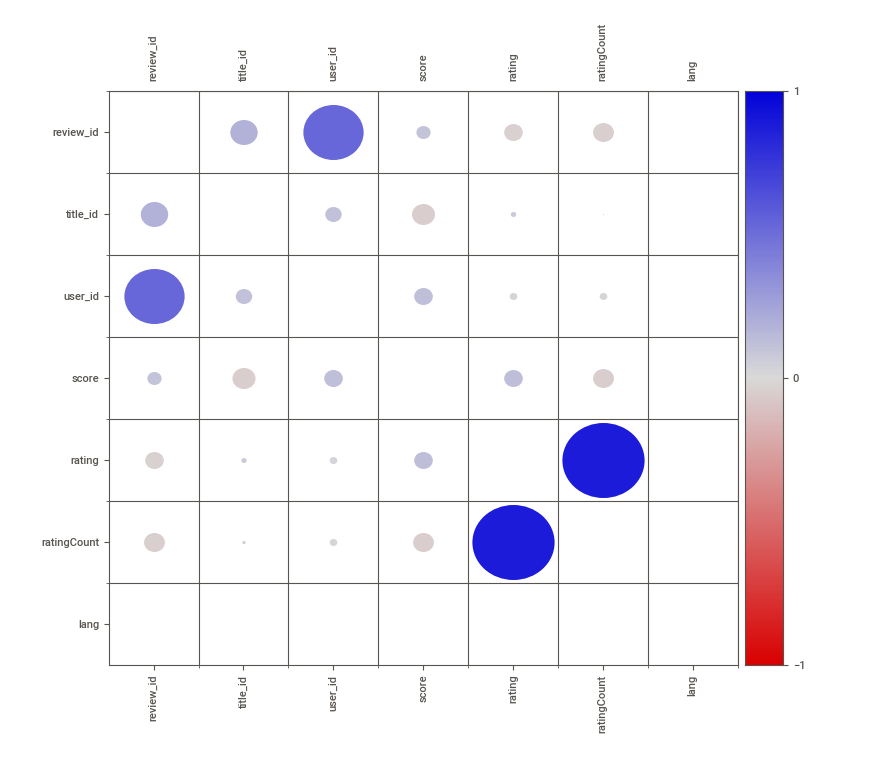
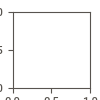

In [ ]:
# Quick EDA using sweetviz: reviews table
display(df_reviews.head())
report=sv.analyze(df_reviews)
report.show_html("eda_reviews.html")
report.show_notebook(w=None, h=None, scale=None, layout="vertical")

,tag_id,tag_name,tag_category,tag_rank,title_id,title_native,title_romaji
0,85,Tragedy,Theme-Drama,97,30002,ベルセルク,Berserk
1,50,Seinen,Demographic,97,30002,ベルセルク,Berserk
2,252,Revenge,Theme-Drama,94,30002,ベルセルク,Berserk
3,82,Male Protagonist,Cast-Main Cast,93,30002,ベルセルク,Berserk
4,15,Demons,Cast-Traits,92,30002,ベルセルク,Berserk


                                             |          | [  0%]   00:00 -> (? left)

Report eda_tags.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



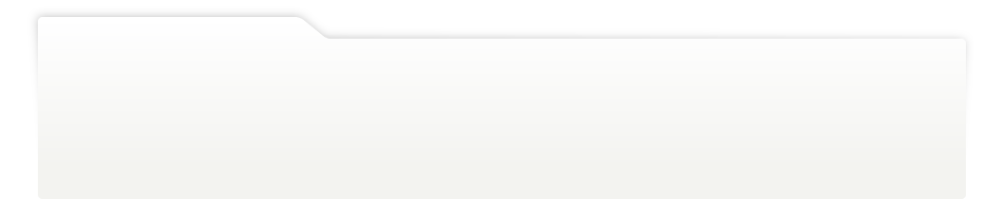
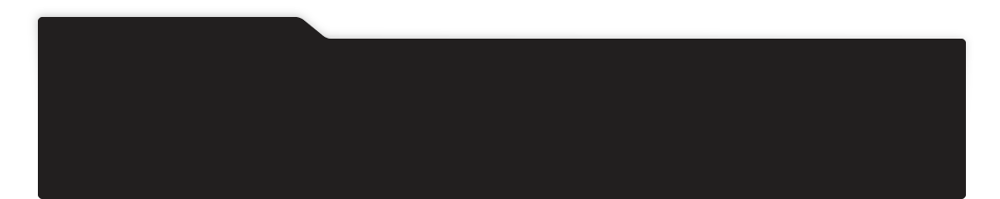
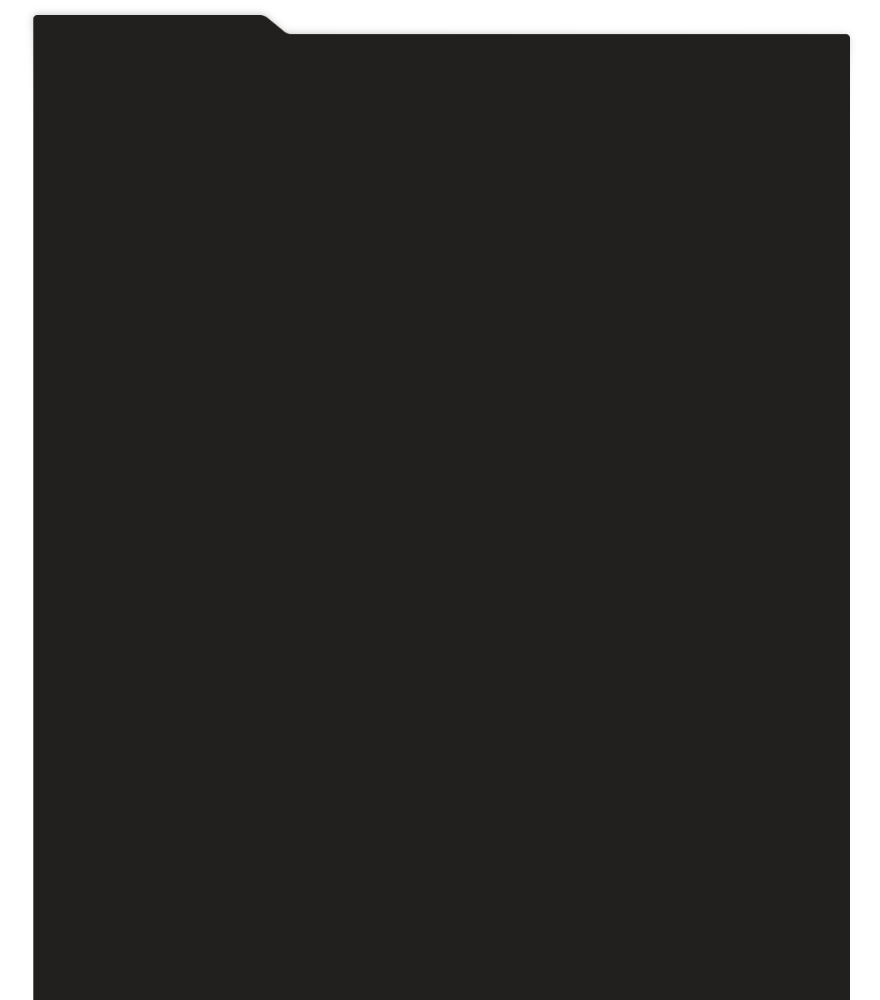
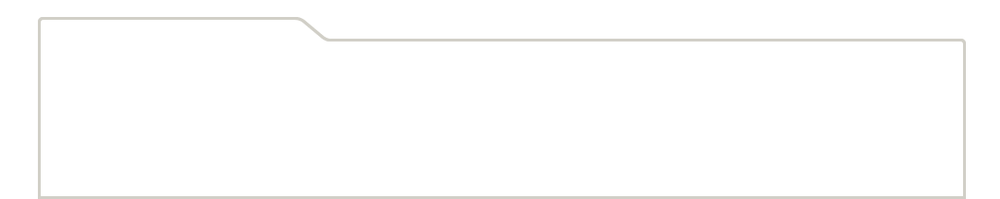
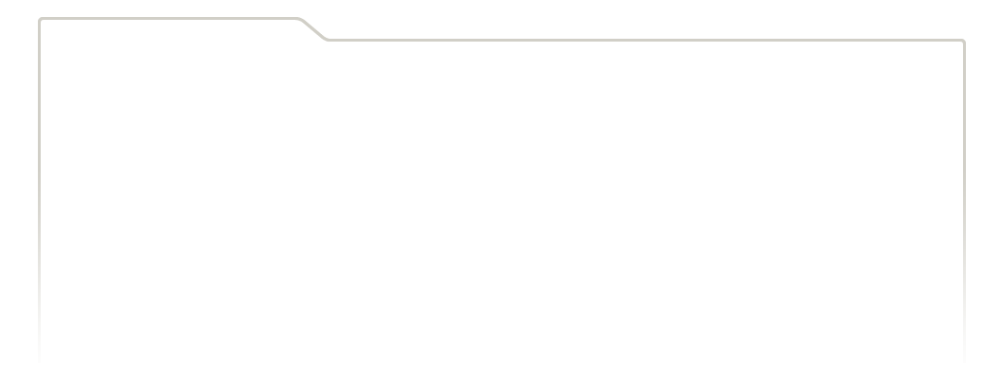
...
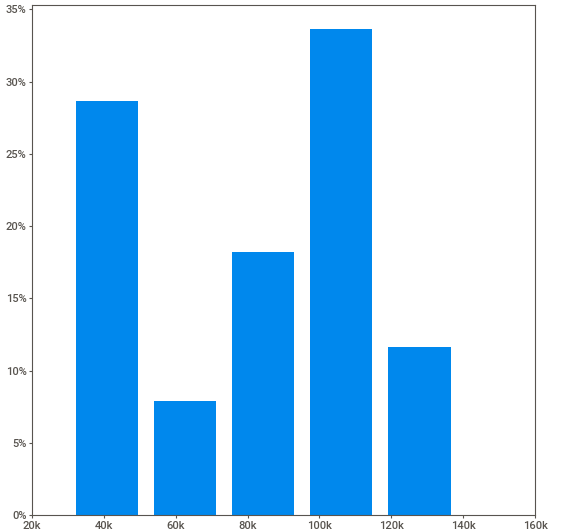
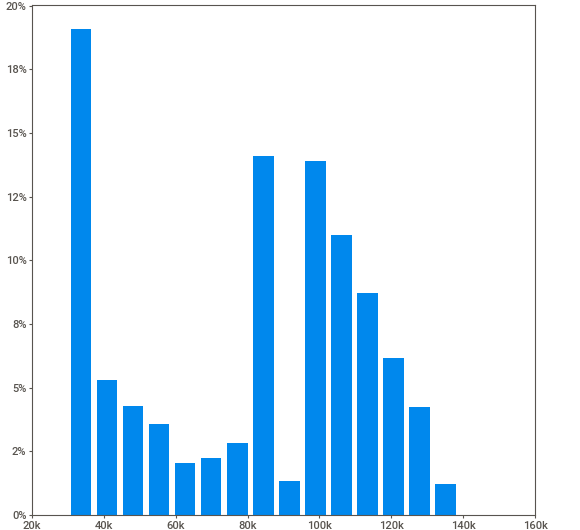
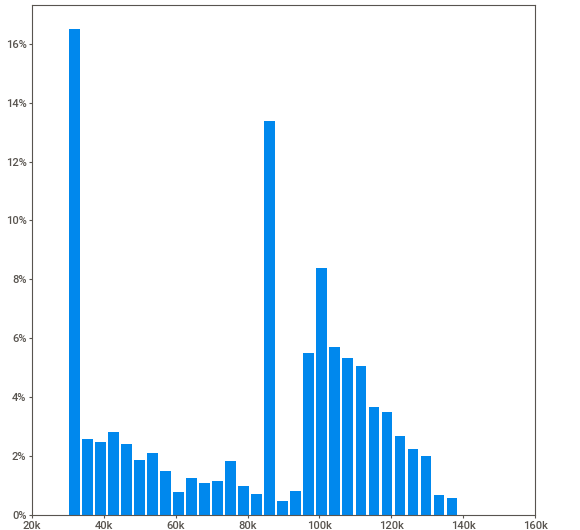
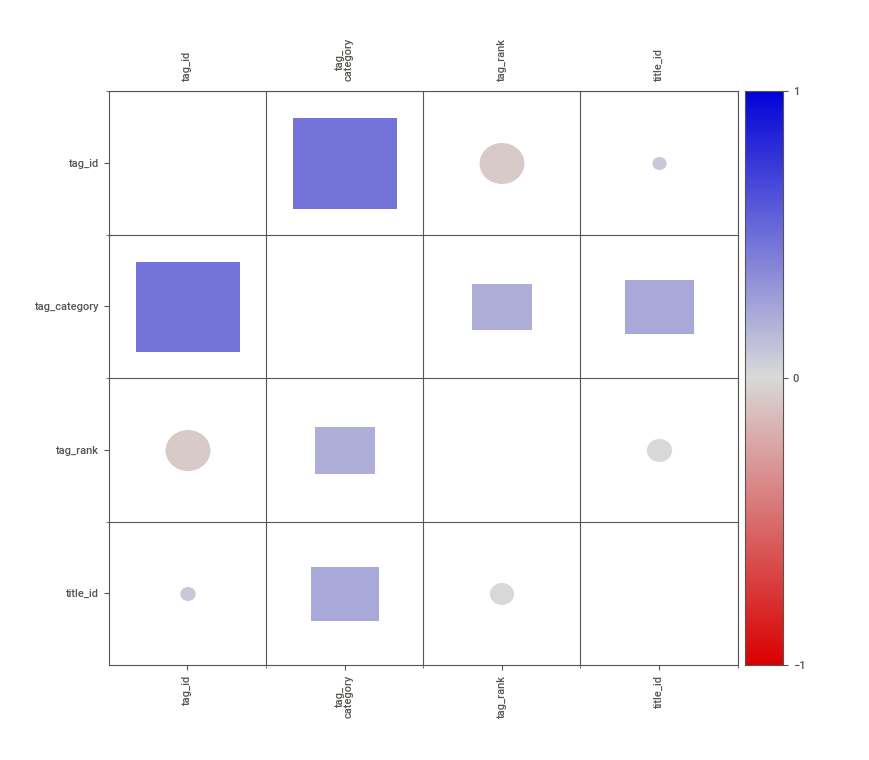
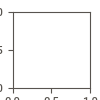

In [ ]:
# Quick EDA using sweetviz: tags table
display(df_tags.head())
report=sv.analyze(df_tags)
report.show_html("eda_tags.html")
report.show_notebook(w=None, h=None, scale=None, layout="vertical")

### Association Analysis on Genres


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,antecedents_length,consequents_length,antecedents_str,consequents_str
6,(Adventure),(Action),0.140498,0.243887,0.101888,0.725191,2.973474,0.067622,2.751412,1,1,Adventure,['Action']
7,(Action),(Adventure),0.243887,0.140498,0.101888,0.417766,2.973474,0.067622,1.476215,1,1,Action,['Adventure']
8,(Fantasy),(Adventure),0.236379,0.140498,0.096954,0.410163,2.919361,0.063743,1.457187,1,1,Fantasy,['Adventure']
9,(Adventure),(Fantasy),0.140498,0.236379,0.096954,0.690076,2.919361,0.063743,2.463900,1,1,Adventure,['Fantasy']
10,(Action),(Fantasy),0.243887,0.236379,0.110039,0.451187,1.908744,0.052389,1.391405,1,1,Action,['Fantasy']
11,(Fantasy),(Action),0.236379,0.243887,0.110039,0.465517,1.908744,0.052389,1.414664,1,1,Fantasy,['Action']
12,(Comedy),(Ecchi),0.402402,0.074432,0.056628,0.140725,1.890662,0.026677,1.077150,1,1,Comedy,['Ecchi']
13,(Ecchi),(Comedy),0.074432,0.402402,0.056628,0.760807,1.890662,0.026677,2.498390,1,1,Ecchi,['Comedy']
14,(Psychological),(Drama),0.104033,0.415916,0.077220,0.742268,1.784659,0.033951,2.266246,1,1,Psychological,['Drama']
15,(Drama),(Psychological),0.415916,0.104033,0.077220,0.185663,1.784659,0.033951,1.100241,1,1,Drama,['Psychological']


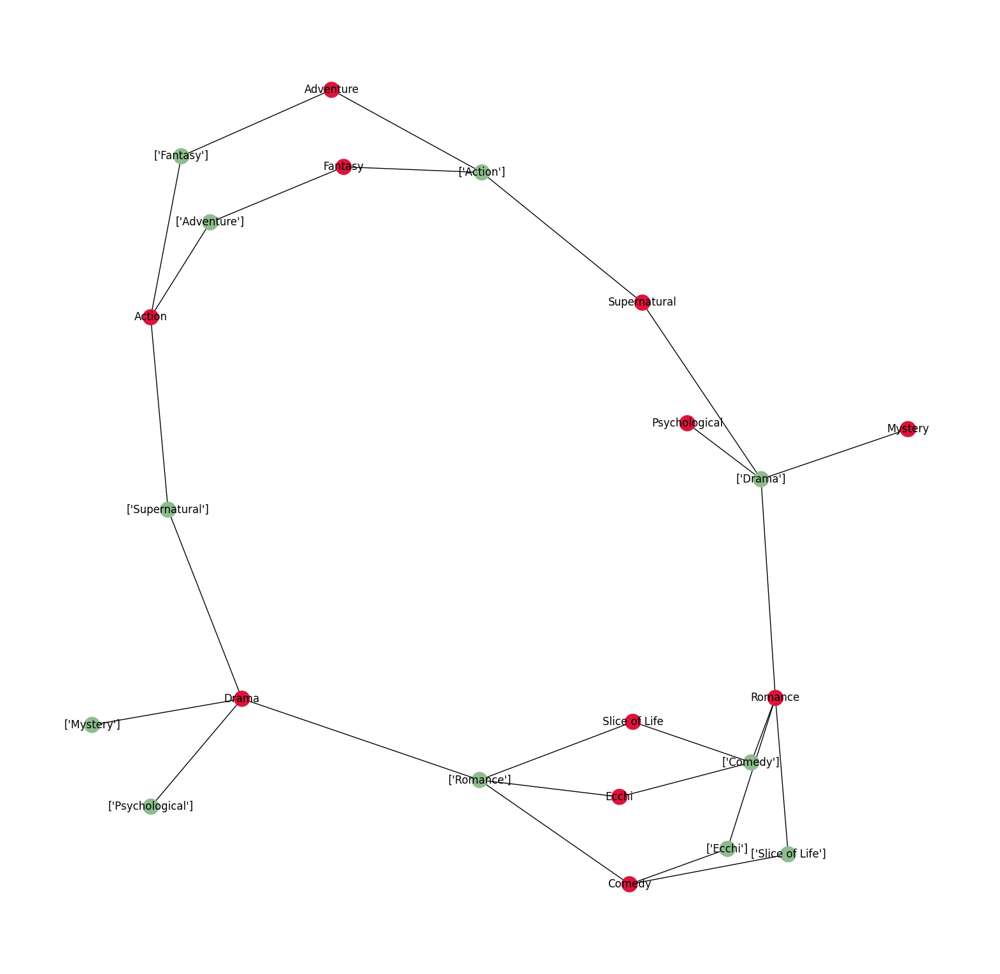

In [ ]:
# Filter the data down to genre columns only
df_genre = df_titles.iloc[:, 32:-2]
df_genre_bool = df_genre.apply(lambda x: x>0)

# Apriori -> Filter results to only those that have more than 2 itemsets, so we can see which patterns occur the most
ap_res = apriori(df_genre_bool, min_support = 0.05, use_colnames = True)
ap_len = ap_res.copy()
ap_len["item_length"] = ap_len["itemsets"].apply(lambda x: len(x))
ap_len = ap_len[ap_len["item_length"] > 1]
ap_len = ap_len.sort_values("support", ascending = False)

# Work out Lift and sort by Lift, also add length of antecendents for clearer interpretation
ap_lift = association_rules(ap_res, metric = "lift", min_threshold = 1)
ap_lift = ap_lift.sort_values("lift", ascending = False).reset_index(drop=True)
ap_lift["antecedents_length"] = ap_lift["antecedents"].apply(lambda x: len(x))
ap_lift["consequents_length"] = ap_lift["consequents"].apply(lambda x: len(x))
ap_lift["antecedents_str"] = ap_lift["antecedents"].apply(lambda x: list(x)[0]).astype("unicode")
ap_lift["consequents_str"] = ap_lift["consequents"].apply(lambda x: list(x)).astype("unicode")

# Filter the lift results to only those with 1 antecedents
ap_lift_len_filtered = ap_lift[(ap_lift["antecedents_length"] == 1) & (ap_lift["consequents_length"] == 1)]
display(ap_lift_len_filtered.head(10))

# Bubble chart to visualize support, confidence, and lift
fig = px.scatter(ap_lift_len_filtered, x="support", y="confidence", size="lift", color="antecedents_str", hover_name="consequents_str")
fig.show()

# Draw with NetworkX
fig, ax=plt.subplots(figsize=(20,20))
G = nx.from_pandas_edgelist(ap_lift_len_filtered, source="antecedents_str", target="consequents_str")
color_map = []
for node in G:
    if node[0] == "[":
        color_map.append('DarkSeaGreen')
    else: 
        color_map.append('crimson')      

nx.draw(G, node_color=color_map, with_labels=True)
plt.show()

### Correlation Analysis of Numerical Features


In [ ]:
# Make correlation heatmap for numerical features
display(df_titles.head())
corr_features = ["start_year", "average_score", "mean_score", "popularity", "favorites", \
                 "score_10", "score_20", "score_30", "score_40", "score_50", "score_60", "score_70", "score_80", "score_90", "score_100", \
                 "count_CURRENT", "count_PLANNING", "count_COMPLETED", "count_DROPPED", "count_PAUSED", "ranking_RATED", "ranking_POPULAR", \
                 "review_count", "tags_count"]

df_titles_corr = df_titles[corr_features].corr()
corr_values = np.flipud(df_titles_corr.values) # Don't know why but it flips the column order so we need to flip them back to original order
z_text = np.around(corr_values, decimals=2)
x_axis_labels = list(df_titles_corr.index)
y_axis_labels = list(df_titles_corr.columns)
fig = ff.create_annotated_heatmap(corr_values, x=x_axis_labels, y=y_axis_labels[::-1], annotation_text=z_text, hoverinfo="z", colorscale="Blues")
fig.update_layout(height=1000, width=1200)
fig.show()

,title_id,title_native,title_romaji,start_year,chapters,volume,publishing_status,country,adult,average_score,mean_score,popularity,favorites,score_10,score_20,score_30,score_40,score_50,score_60,score_70,score_80,score_90,score_100,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,ranking_RATED,ranking_POPULAR,synopsis,cover_image_url,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count
0,30002,ベルセルク,Berserk,1989.0,NaN,NaN,RELEASING,JP,False,92,92,86848,15709,458.0,25.0,50.0,77.0,157.0,282.0,872,2378,7428,18605,41061,28339,7584,1300,8564,1.0,7.0,"His name is Guts, the Black Swordsman, a feare...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,10.0,36.0
1,30013,ONE PIECE,ONE PIECE,1997.0,NaN,NaN,RELEASING,JP,False,91,91,83201,17391,239.0,41.0,69.0,140.0,337.0,620.0,1730,3798,9344,20963,57479,12759,3088,2567,7308,1.0,1.0,"As a child, Monkey D. Luffy was inspired to be...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,11.0,54.0
2,31706,ジョジョの奇妙な冒険 スティール・ボール・ラン,JoJo no Kimyou na Bouken: Steel Ball Run,2004.0,95.0,24.0,FINISHED,JP,False,91,91,40754,8341,375.0,9.0,18.0,41.0,74.0,177.0,632,1651,5591,11017,4899,11582,22916,265,1092,1.0,1.0,"Originally presented as an unrelated story, th...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,5.0,20.0
3,30656,バガボンド,Vagabond,1999.0,NaN,NaN,RELEASING,JP,False,90,90,49289,6265,230.0,5.0,16.0,26.0,86.0,153.0,479,1385,3884,6961,13310,24352,6589,514,4524,1.0,1.0,"At seventeen years of age, Miyamoto Musashi--s...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8.0,20.0
4,30001,MONSTER,MONSTER,1994.0,162.0,18.0,FINISHED,JP,False,90,90,38251,4010,144.0,5.0,18.0,30.0,79.0,128.0,424,1146,3337,5410,4210,20159,12143,304,1435,1.0,1.0,Everyone faces uncertainty at some point in th...,{'large': 'https://s4.anilist.co/file/anilistc...,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,5.0,16.0


---
## Unsupervised Learning

---

### Common functions

#### Text Preprocessing Functions

In [ ]:
def clean_text(txt):
    try:
        # Get rid of html tags and clean out the source description
        c_tag = re.compile("<.*?>")
        clean_txt = re.sub(c_tag, "", txt)
        c_source = re.compile("\((Source: .*?)\)")
        clean_txt = re.sub(c_source, "", clean_txt)
        # Get rid of \n
        clean_txt = ' '.join(clean_txt.split())
        # Get rid of any "notes" made
        c_notes = re.compile("Notes:.*|Note:.*|notes:.*|note:.*")
        clean_txt = re.sub(c_notes, '', clean_txt)
        # lowering characters
        # clean_txt = clean_txt.lower()
        # removing punctuations and numbers
        clean_txt = re.sub("[^A-Za-z]+", " ", clean_txt)
        # removing stopwords
        clean_txt = [word for word in clean_txt.split() if word not in stop_words]
        clean_txt = ' '.join(clean_txt)
        return clean_txt
    except: 
        print(txt) # nan can cause this error but if anything else happens

def extract_source(txt):
    try:
        match = re.findall("\((Source: .*?)\)", txt)
        source = re.findall("(?<=Source: ).*$", match[0])
        return source[0]
    except:
        return "no match"

def word_count(txt):
    try:
        word_count = len(txt)
        return word_count
    except:
        return 0

def preprocess_text(txt):
    # text = re.sub("\S{2,}", " ", text) # remove single character words 
    txt = re.sub("\s*[A-Z]\w*\s*", " ", txt) # remove named entities by capital letter (it removes the first word of sentences but try)
    tokens = word_tokenize(txt)
    tokens = [x for x in tokens if x in w2v_model.wv.vocab] # exclude non-word2vec words as there are just too many names and romaji (japanese words in alphabets)
    # lemmatiser = WordNetLemmatizer()
    # tokens = [lemmatiser.lemmatize(t, pos='v') for t in tokens]
    return tokens

# Function to filter the synopsis source to only those in the provided list (source_to_keep)
def filter_synopsis_source(txt, source_to_keep):
    if txt not in source_to_keep:
        return "no match or too few"
    else:
        return txt

def clean_review_img_tags(tokens):
    clean_word_list = ['http', 'https', 'com', 'png', 'jpg', 'nj', 'jpeg', 'bep']
    tokens = [x for x in tokens if x not in clean_word_list]
    tokens = [x for x in tokens if len(x) > 1]
    return tokens


#### Evaluation Functions

In [ ]:
# Coherence scores for LDA
def topic_coherence(words_list):
    try:
        result_list = []
        for word in words_list:
            if word not in w2v_model.wv:
                words_list.remove(word)
            else:
                word_vec = w2v_model.wv[word]
                result_list.append(word_vec)
        word_vec_arr = np.array(result_list)
        pair_dist_mat = 1 - pairwise_distances(word_vec_arr, metric="cosine")
        np.fill_diagonal(pair_dist_mat, 0)
    except KeyError as e:
        pass
    return pair_dist_mat.mean()

#### Plotting Functions

In [ ]:
# Function to plot db and ch scores
def plot_db_ch_scores(X, cluster_max=20, convert_dense=True, title="None"):
    cluster_no, db_scores, ch_scores = [], [], []
    for i in range(2, cluster_max):
        km = KMeans(n_clusters=i, init="k-means++", max_iter=100, n_init=1, random_state=42).fit(X)
        labels = km.labels_
        if convert_dense == True:
            X_dense = X.todense()
            cluster_no.append(i)
            db_scores.append(metrics.davies_bouldin_score(X_dense, labels))
            ch_scores.append(metrics.calinski_harabasz_score(X_dense, labels))
        else:
            cluster_no.append(i)
            db_scores.append(metrics.davies_bouldin_score(X, labels))
            ch_scores.append(metrics.calinski_harabasz_score(X, labels))

    # Plot DB and CH scores with plotly
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=cluster_no, y=db_scores, mode="lines", name="davies_bouldin_score"))
    fig.add_trace(go.Scatter(x=cluster_no, y=ch_scores, mode="lines", name="calinski_harabasz_score"))
    fig.update_layout(title=title, width=700)
    fig.show()

# Check representative terms for each cluster
def check_rep_terms(cluster_model, vectorizer, cluster_no):
    centroids = cluster_model.cluster_centers_
    centroids_sorted = np.argsort(-centroids)
    terms = vectorizer.get_feature_names()
    result = []
    for i in range(cluster_no):
        per_cluster_list = []
        for ind in centroids_sorted[i, :20]: # get top 20 terms that are most representative of a cluster
            per_cluster_list.append(terms[ind])
        result.append(per_cluster_list)
    result_df = pd.DataFrame(result)
    return result_df

# Get cluster labels and join labels to titles
def check_cluster_ratio(X, cluster_labels, df_titles, df_genre, title):
    cluster_labels = np.expand_dims(cluster_labels, axis=1)
    title_cluster_label = np.concatenate((cluster_labels, title_values), axis=1)
    df_title_cluster = pd.DataFrame(title_cluster_label, columns=["cluster_no", "title"])    
    df_title_count = df_title_cluster.groupby("cluster_no").agg(["count"]) # Look at count and see how much ratio each cluster occupies
    title_count_cols = list(df_title_count.columns)
    title_count_cols[0] = "title_count"
    df_title_count.columns = title_count_cols

    # Pie chart
    fig = px.pie(df_title_count, values="title_count", names=df_title_count.index, title="Cluster ratio"+title)
    fig.show()

    # Look into the genres distribution that each cluster has
    # join cluster and genre df -> see if each cluster has any patterns in the genre it belongs to
    df_cluster_genre = pd.concat([df_title_cluster, df_genre], axis=1)
    df_cluster_genre = df_cluster_genre.loc[:, df_cluster_genre.columns != "title"]
    df_genre_count = df_cluster_genre.groupby("cluster_no").sum()

    # Normalize to "per cluster genre ratio" (ratio of titles under certain genre for each cluster)
    df_title_genre_count = pd.concat([df_title_count, df_genre_count], axis=1)
    cols = list(df_title_genre_count.columns)
    cols[0] = "title_count" # rename the first column
    df_title_genre_count.columns = cols
    df_title_genre_count = df_title_genre_count.iloc[:,1:].div(df_title_genre_count["title_count"], axis=0)

    # Heatmap
    fig, ax = plt.subplots(figsize=(15,5))
    plt.title("Cluster Characteristics: Ratio of Titles Under Certain Genre"+title, fontdict = {"size": 20})
    sns.heatmap(ax=ax, data=df_title_genre_count, annot=True, fmt=".2", cmap="Blues")
    plt.show()

# Function to prepare label array for embedding projector visualization
def prep_label_array(df, columns):
    flag_list = []
    for col in columns:
        flag_list.append(np.expand_dims(np.array(df[col]), axis=1))
    meta = np.concatenate(flag_list, axis=1)
    renamed_cols = [c+"_flag" for c in columns]
    meta_header = np.insert(meta, 0, renamed_cols, axis=0)
    return meta_header


### Synopsis Text Data

#### Preprocessing Synopsis Text

In [ ]:
# We use the text8_w2v model that was trained and saved on drive
# Please download the actual pickle file as it cannot be shared on github due to the file size
# https://drive.google.com/file/d/1LcPSJjg_zH89_14_JW91nA0WQH6RDYuf/view?usp=sharing
f = open("drive/MyDrive/694_Milestone II/w2v_text8_model.pkl", "rb")
w2v_model = pickle.load(f)
f.close()

# Drop na
print(len(df_titles))
df_titles = df_titles[df_titles["synopsis"].notna()]
print(len(df_titles))

# Check
test = df_titles["synopsis"][0]
print(test)
print(clean_text(test))
print(extract_source(test))
print(word_count(clean_text(test)))

df_titles["synopsis_cleaned"] = df_titles["synopsis"].apply(lambda x: clean_text(x))
# df_titles["synopsis_cleaned_rejoin"] = df_titles["synopsis_cleaned"].apply(lambda x: ' '.join(x))
df_titles["synopsis_source"] = df_titles["synopsis"].apply(lambda x: extract_source(x))
df_titles["synopsis_wc"] = df_titles["synopsis_cleaned"].apply(lambda x: word_count(x))

# Check the rows with weirdly long synopsis word count for checking
mean_wc = df_titles["synopsis_wc"].mean()
std_wc = df_titles["synopsis_wc"].std()
df_check_high = df_titles[df_titles["synopsis_wc"] > (mean_wc + 3 * std_wc)]
df_check_low = df_titles[df_titles["synopsis_wc"] < (mean_wc - 3 * std_wc)]
print("sample count that are high bound anomalies: ", len(df_check_high))
print("sample count that are low bound anomalies: ",len(df_check_low))

# Further preprocessing
df_titles["synopsis_cleaned_further"] = df_titles["synopsis_cleaned"].apply(lambda x: preprocess_text(x))

# Further preprocessing of the synopsis source
df_major_sources = df_titles.groupby("synopsis_source").filter(lambda x : len(x)>30)
source_to_keep = df_major_sources["synopsis_source"].unique()
source_to_keep = source_to_keep[source_to_keep != "no match"]
df_titles["synopsis_source_filtered"] = df_titles["synopsis_source"].apply(lambda x: filter_synopsis_source(x, source_to_keep))
print("main synopsis sources: ", df_titles["synopsis_source_filtered"].value_counts())
display(df_titles.head())


4667
4648
His name is Guts, the Black Swordsman, a feared warrior spoken of only in whispers. Bearer of a gigantic sword, an iron hand, and the scars of countless battles and tortures, his flesh is also indelibly marked with The Brand, an unholy symbol that draws the forces of darkness to him and dooms him as their sacrifice. But Guts won't take his fate lying down; he'll cut a crimson swath of carnage through the ranks of the damned—and anyone else foolish enough to oppose him! Accompanied by Puck the Elf, more an annoyance than a companion, Guts relentlessly follows a dark, bloodstained path that leads only to death...or vengeance.<br>
<br>
(Source: Dark Horse)<br>
<br>
<i>Notes:<br>
- Volumes 1-5 contain the 16 prequel chapters 0A - 0P.<br>
- <a href="https://anilist.co/manga/95821/">Chapter 83</a> was omitted from Volume 13 due to the author’s request.<br>
- Volume 14 includes “<a href="https://anilist.co/manga/36408/">Berserk: The Prototype</a>”.<br>
- The series is currently on i

,title_id,title_native,title_romaji,start_year,chapters,volume,publishing_status,country,adult,average_score,mean_score,popularity,favorites,score_10,score_20,score_30,score_40,score_50,score_60,score_70,score_80,score_90,score_100,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,ranking_RATED,ranking_POPULAR,synopsis,cover_image_url,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count,synopsis_cleaned,synopsis_source,synopsis_wc,synopsis_cleaned_further,synopsis_source_filtered
0,30002,ベルセルク,Berserk,1989.0,NaN,NaN,RELEASING,JP,False,92,92,86848,15709,458.0,25.0,50.0,77.0,157.0,282.0,872,2378,7428,18605,41061,28339,7584,1300,8564,1.0,7.0,"His name is Guts, the Black Swordsman, a feare...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,10.0,36.0,His name Guts Black Swordsman feared warrior s...,Dark Horse,425,"[name, feared, warrior, spoken, whispers, giga...",no match or too few
1,30013,ONE PIECE,ONE PIECE,1997.0,NaN,NaN,RELEASING,JP,False,91,91,83201,17391,239.0,41.0,69.0,140.0,337.0,620.0,1730,3798,9344,20963,57479,12759,3088,2567,7308,1.0,1.0,"As a child, Monkey D. Luffy was inspired to be...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,11.0,54.0,As child Monkey D Luffy inspired become pirate...,Viz Media,348,"[child, inspired, become, pirate, listening, t...",Viz Media
2,31706,ジョジョの奇妙な冒険 スティール・ボール・ラン,JoJo no Kimyou na Bouken: Steel Ball Run,2004.0,95.0,24.0,FINISHED,JP,False,91,91,40754,8341,375.0,9.0,18.0,41.0,74.0,177.0,632,1651,5591,11017,4899,11582,22916,265,1092,1.0,1.0,"Originally presented as an unrelated story, th...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,5.0,20.0,Originally presented unrelated story series la...,Wikipedia,346,"[presented, unrelated, story, series, later, o...",Wikipedia
3,30656,バガボンド,Vagabond,1999.0,NaN,NaN,RELEASING,JP,False,90,90,49289,6265,230.0,5.0,16.0,26.0,86.0,153.0,479,1385,3884,6961,13310,24352,6589,514,4524,1.0,1.0,"At seventeen years of age, Miyamoto Musashi--s...",{'large': 'https://s4.anilist.co/file/anilistc...,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8.0,20.0,At seventeen years age Miyamoto Musashi still ...,Viz Media,357,"[seventeen, years, age, still, known, childhoo...",Viz Media
4,30001,MONSTER,MONSTER,1994.0,162.0,18.0,FINISHED,JP,False,90,90,38251,4010,144.0,5.0,18.0,30.0,79.0,128.0,424,1146,3337,5410,4210,20159,12143,304,1435,1.0,1.0,Everyone faces uncertainty at some point in th...,{'large': 'https://s4.anilist.co/file/anilistc...,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,5.0,16.0,Everyone faces uncertainty point lives Even br...,Viz Media,524,"[faces, uncertainty, point, lives, brilliant, ...",Viz Media


#### Topic distribution by LDA

In [ ]:
# Create tfidf corpus
synopsis_docs = df_titles["synopsis_cleaned_further"]
dictionary = gensim.corpora.Dictionary(synopsis_docs)
dictionary.filter_extremes(no_below=2, no_above=0.3, keep_n=1000000)
bow = [dictionary.doc2bow(doc) for doc in synopsis_docs]
tf_gensim = models.TfidfModel(bow)
corpus_tfidf = tf_gensim[bow]

In [ ]:
# Run LDA for range of topic number settings
coherence_score_list = []
topic_range = list(range(3,20)) # Anything above 20 just went down, so narrowed it down to 20 for faster run
for num_topic in topic_range:
    lda_model_tfidf = gensim.models.LdaMulticore(corpus_tfidf, num_topics=num_topic, id2word=dictionary, passes=2, workers=CPU_COUNT, random_state=42)
    topics = lda_model_tfidf.show_topics(num_topics=-1, num_words=20, formatted=False)
    all_topics_score = []
    for topic in topics:
        words_list = [words[0] for words in topic[1]]
        # print("Topic: {}, Coherence Score: {}".format(topic[0], topic_coherence(words_list))) # uncomment if you want to see the log
        all_topics_score.append(topic_coherence(words_list))
    coherence_score_mean = np.array(all_topics_score).mean()
    print("No. of topics parameter: {}, mean topic coherence score: {}".format(num_topic, coherence_score_mean))
    coherence_score_list.append([num_topic, coherence_score_mean])

coherence_score_array = np.array(coherence_score_list)
fig = go.Figure()
fig.add_trace(go.Scatter(x=coherence_score_array[:, 0], y=coherence_score_array[:, 1], mode="lines", name="Explained variance"))
fig.update_yaxes(range=[0.1, 0.16])
fig.update_layout(title="Coherence scores for different number of topics", width=700)
fig.show()


No. of topics parameter: 3, mean topic coherence score: 0.14148762822151184
No. of topics parameter: 4, mean topic coherence score: 0.140645831823349
No. of topics parameter: 5, mean topic coherence score: 0.15412327647209167
No. of topics parameter: 6, mean topic coherence score: 0.13989494740962982
No. of topics parameter: 7, mean topic coherence score: 0.12560489773750305
No. of topics parameter: 8, mean topic coherence score: 0.13615471124649048
No. of topics parameter: 9, mean topic coherence score: 0.1340235024690628
No. of topics parameter: 10, mean topic coherence score: 0.12388410419225693
No. of topics parameter: 11, mean topic coherence score: 0.12983952462673187
No. of topics parameter: 12, mean topic coherence score: 0.12953504920005798
No. of topics parameter: 13, mean topic coherence score: 0.1297542154788971
No. of topics parameter: 14, mean topic coherence score: 0.13102133572101593
No. of topics parameter: 15, mean topic coherence score: 0.13038070499897003
No. of top

In [ ]:
# The coherence score comparison tells us that having 5 topics might be the most comprehensive number of topics setting. 
# Set topic number first
NUM_TOPICS = 5
lda_model_tfidf = gensim.models.LdaMulticore(corpus_tfidf, num_topics=NUM_TOPICS, id2word=dictionary, passes=2, workers=CPU_COUNT, random_state=42)

# Map topic probabilities to each title
df_list = []
for b in bow:
    res = lda_model_tfidf.get_document_topics(b)
    res_dict = dict(res)
    df = pd.DataFrame(res_dict, index=['i',])
    df_list.append(df)
df_topic_prob = pd.concat(df_list, axis=0)
df_topic_prob = df_topic_prob.fillna(0)
# display(df_topic_prob.head())

df_topic_prob.reset_index(drop=True, inplace=True)
df_titles.reset_index(drop=True, inplace=True)
df_titles_topic_prob = pd.concat([df_titles, df_topic_prob], axis=1)
# display(df_titles_topic_prob.head())

# Visualize genre x topic probability to understand what each of 10 topics might be close to represent
genre_cols = ["Action", "Adventure", "Comedy", "Drama", "Ecchi", \
               "Fantasy", "Hentai", "Horror", "Mahou Shoujo", "Mecha", \
               "Music", "Mystery", "Psychological", "Romance", "Sci-Fi", 
               "Slice of Life", "Sports", "Supernatural", "Thriller"]

genre_topic_prob = []
for genre_col in genre_cols:
    df_topic_check = df_titles_topic_prob[df_titles_topic_prob[genre_col] == 1]
    topic_cols = range(NUM_TOPICS)
    for topic_col in topic_cols:
        # print("Genre: {}, Topic: {}, Mean topic probability: {}".format(genre_col, topic_col, df_topic_check[topic_col].mean()))
        genre_topic_prob.append([genre_col, topic_col, df_topic_check[topic_col].mean()])
df_genre_topic = pd.DataFrame(genre_topic_prob, columns=["genre", "topic_no", "mean_topic_probability"])
display(df_genre_topic)


,genre,topic_no,mean_topic_probability
0,Action,0,0.208297
1,Action,1,0.210440
2,Action,2,0.131423
3,Action,3,0.190360
4,Action,4,0.243374
...,...,...,...
90,Thriller,0,0.289520
91,Thriller,1,0.179334
92,Thriller,2,0.093792
93,Thriller,3,0.236280


In [ ]:
# Plot topic probability mean for each genre
genres_to_plot = []
for genre_col in genre_cols:
    df_genre_count_check = df_titles_topic_prob[df_titles_topic_prob[genre_col] == 1]
    print("Count of rows for {}: {}".format(genre_col, len(df_genre_count_check)))
    if len(df_genre_count_check) > 100:
        genres_to_plot.append(genre_col)

df_genre_topic = df_genre_topic[df_genre_topic["genre"].isin(genres_to_plot)]
df_genre_topic["topic_no"] = df_genre_topic["topic_no"].astype(str)
fig = px.line_polar(df_genre_topic, r="mean_topic_probability", theta="topic_no", color="genre", line_close=True)
fig.update_layout(
    polar = dict(
        radialaxis = dict(range=[0, 0.35])
    )
)
fig.show()

# Filter the topic_prob x genres df to only the close genres based on the association analysis output
plot_pattern_lists = [
    ["Adventure", "Action", "Fantasy"],
    ["Psychological", "Supernatural", "Mystery"],
    ["Romance", "Comedy", "Slice of Life"]
]

for plot_pattern in plot_pattern_lists: # replace with ap_res["itemsets_str"] if you want to plot by association rules
    df_plot = df_genre_topic[df_genre_topic["genre"].isin(plot_pattern)]
    fig = px.line_polar(df_plot, r="mean_topic_probability", theta="topic_no", color="genre", line_close=True)
    fig.update_layout(
        title=str(plot_pattern),
        polar = dict(
            radialaxis = dict(range=[0, 0.35])
        )
    )
    fig.show()


# Take patterns with the highest

# # Test a few texts
# # 1: Uchu-Kyodai, 2: Naruto, 3: Jaguar, 4: komi-san
# test_text_1 = "Space Brothers (Uchū Kyōdai 宇宙兄弟) is a Japanese manga series by Chūya Koyama serialized in Kodansha's Weekly Morning. The series follows the story of two brothers, Nanba Mutta and Nanba Hibito who witnessed a UFO on a fateful night and decided to become astronauts. While Hibito fulfilled his dreams and became an astronaut who is set to leave on a mission to the moon, Mutta who recently lost his job enters the JAXA astronaut selection program and takes a step closer towards joining his brother."
# test_text_2 = "Twelve years before the start of the series, the Nine-Tails attacked Konohagakure destroying much of the village and taking many lives. The leader of the village, the Fourth Hokage, sacrificed his life to seal the Nine-Tails into a newborn, Naruto Uzumaki. Orphaned by the attack, Naruto was shunned by the villagers, who out of fear and anger, viewed him as the Nine-Tails itself. Though the Third Hokage outlawed speaking about anything related to the Nine-Tails, the children — taking their cues from their parents — inherited the same animosity towards Naruto. In his thirst to be acknowledged, Naruto vowed he would one day become the greatest Hokage the village had ever seen."
# test_text_3 = "A young man who tries to become a guitarist meets another man who is a specialist in flutes. This comedy series revolves around the man with the flute, who makes many surreal jokes and comments"

# bow_vector = dictionary.doc2bow(word_tokenize(test_text_1))
# for index, score in sorted(lda_model_tfidf[bow_vector], key=lambda tup: -1*tup[1]):
#     print("Score: {}\t Topic: {}".format(score, lda_model_tfidf.print_topic(index, 5)))

# bow_vector = dictionary.doc2bow(word_tokenize(test_text_2))
# for index, score in sorted(lda_model_tfidf[bow_vector], key=lambda tup: -1*tup[1]):
#     print("Score: {}\t Topic: {}".format(score, lda_model_tfidf.print_topic(index, 5)))

# bow_vector = dictionary.doc2bow(word_tokenize(test_text_3))
# for index, score in sorted(lda_model_tfidf[bow_vector], key=lambda tup: -1*tup[1]):
#     print("Score: {}\t Topic: {}".format(score, lda_model_tfidf.print_topic(index, 5)))


Count of rows for Action: 1137
Count of rows for Adventure: 655
Count of rows for Comedy: 1876
Count of rows for Drama: 1939
Count of rows for Ecchi: 347
Count of rows for Fantasy: 1102
Count of rows for Hentai: 205
Count of rows for Horror: 283
Count of rows for Mahou Shoujo: 34
Count of rows for Mecha: 35
Count of rows for Music: 51
Count of rows for Mystery: 418
Count of rows for Psychological: 485
Count of rows for Romance: 2497
Count of rows for Sci-Fi: 316
Count of rows for Slice of Life: 1133
Count of rows for Sports: 142
Count of rows for Supernatural: 784
Count of rows for Thriller: 95


#### Vectorize with tf-idf

In [ ]:
# synopsis text
synopsis_text = df_titles["synopsis_cleaned"].values

# Count the vocabulary first so we can set the appropriate "max_features" option
tf_check = TfidfVectorizer(max_features=None).fit(synopsis_text)
print("vocabulary length of all synopsis text: ", tf_check.vocabulary_.__len__())

# Set vectorizer after looking at the above vocabulary length
# We won't use bigram as ngram_range as we think there won't be much of two-word terms that are rare enough and representative (and also computational reasons as well)
tf = TfidfVectorizer(max_features=10000, 
                     min_df=3, max_df=0.2, 
                     ngram_range = (1,1), 
                     stop_words="english",
                     analyzer=preprocess_text,
                     use_idf=True)

X = tf.fit_transform(df_titles["synopsis_cleaned"].values)
X_dense = X.todense() # Prep dense version of matrix -> PCA cannot handle sparse matrix
excluded_words = tf.stop_words_
print("vocabulary length of vectorized synopsis text: ", tf.vocabulary_.__len__())
print("count of excluded words: ", len(excluded_words))
# print("excluded words: ", random.sample(excluded_words, len(excluded_words))) # Pretty much only the stopwords are removed

# df_check = df_titles.head(10)
# for index, row in df_check.iterrows():
#     print(row["synopsis"], "\n")
#     print(row["synopsis_cleaned"], "\n")
#     print(row["synopsis_cleaned_further"], "\n")

vocabulary length of all synopsis text:  23757
vocabulary length of vectorized synopsis text:  6205
count of excluded words:  6528


##### Clustering on TfIdf Vectors

In [ ]:
# Run K-Means clustering. DB: lower the better, CH: Higher the better
plot_db_ch_scores(X, 10, convert_dense=True, title="Clustering TfIdf vectors directly: Davies_Bouldin and Calinski-Harabasz")

In [ ]:
# Just as a trial, try running with 4 clusters and run PCA, as "5" seems the best if not worse

# No need to do standardscaler before PCA as all values are in the same unit (tfidf values)
cluster_labels = KMeans(n_clusters=4, init="k-means++", max_iter=100, n_init=1, random_state=42).fit_predict(X)
pca = PCA(n_components=3, random_state=42)
pca_tf_idf = pca.fit_transform(X_dense)

# Add titles so we can see how they are clustered
title_values = df_titles["title_romaji"].values
title_values = np.expand_dims(title_values, axis=1)
pca_tf_idf_title = np.append(pca_tf_idf, title_values, axis=1)

# Visualize in 3D
fig = px.scatter_3d(
    pca_tf_idf_title, x=pca_tf_idf_title[:, 0], y=pca_tf_idf_title[:, 1], z=pca_tf_idf_title[:, 2], hover_data=[3], color=cluster_labels
)
fig.show()


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,love,high,girl,story,two,first,day,student,feelings,friend,relationship,boy,friends,like,secret,falls,childhood,get,heart,time
1,world,new,years,manga,young,series,game,human,stories,power,time,man,mysterious,people,become,family,magic,day,death,back
2,high,girl,day,student,year,friends,new,old,boy,like,friend,time,get,first,two,class,finds,make,family,find
3,story,girl,two,man,manga,series,boy,side,named,main,follows,around,young,place,new,people,together,short,novel,volume


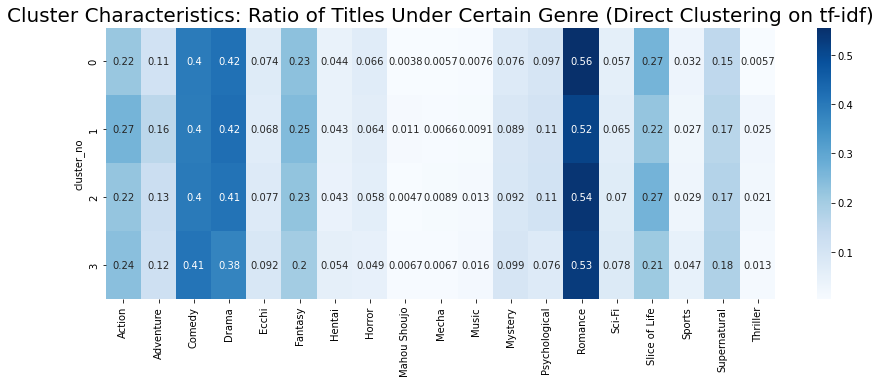

In [ ]:
# Cluster checking functions

# Do the word checking that was used in the assignment
km = KMeans(n_clusters=4, init="k-means++", max_iter=100, n_init=1, random_state=42).fit(X)
cluster_labels = km.predict(X)
df_rep_terms = check_rep_terms(km, tf, 4)
display(df_rep_terms)

# Check cluster ratio
df_genre = df_titles.iloc[:, 32:-7]
check_cluster_ratio(X, cluster_labels, df_titles, df_genre, " (Direct Clustering on tf-idf)")

##### Dimension Reduction on tf-idf

In [ ]:
# Remove the outliers that we saw in the previous PCA
pca = PCA(n_components=3, random_state=42)
pca_tf_idf = pca.fit_transform(X_dense)
outlier_idx = np.where(pca_tf_idf[:,2]>0.5)
display(df_titles.index[outlier_idx])
df_titles = df_titles.drop(df_titles.index[outlier_idx])
df_genre = df_titles.iloc[:, 32:-7]

# Reconstruct X and X_dense
X = tf.fit_transform(df_titles["synopsis_cleaned"].values)
X_dense = X.todense()

# Extract title values before PCA and SVD
title_values = df_titles["title_romaji"].values
title_values = np.expand_dims(title_values, axis=1)

Int64Index([], dtype='int64')

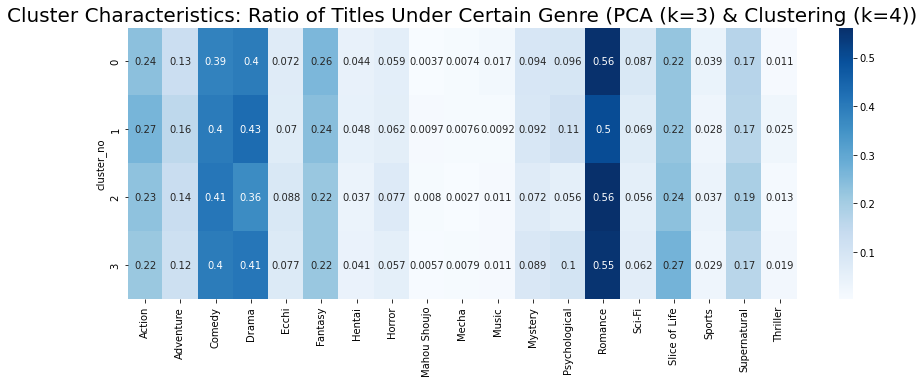

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning:

The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.



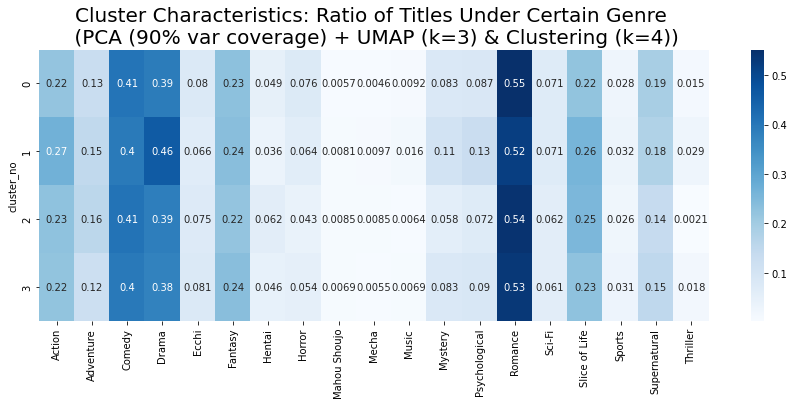

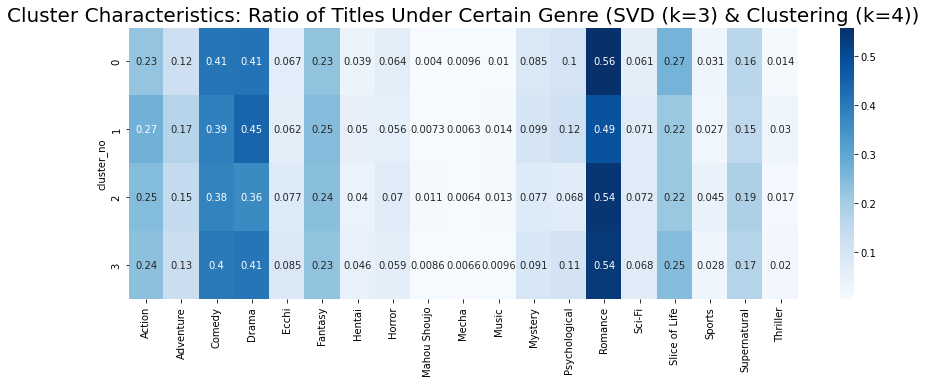

In [ ]:
# =============================== PCA ====================================

# Try DB and CH scores again (Reminder: DB=lower the better, CH=Higher the better)
pca = PCA(n_components=3, random_state=42)
pca_tf_idf = pca.fit_transform(X_dense)
plot_db_ch_scores(pca_tf_idf, 10, convert_dense=False, title="Clustering TfIdf vectors after PCA (k=3): Davies_Bouldin and Calinski-Harabasz Scores")

# Run PCA -> Clustering -> 3D plot
km = KMeans(n_clusters=4, init="k-means++", max_iter=100, n_init=1, random_state=42).fit(pca_tf_idf)
km_labels = km.predict(pca_tf_idf)

# Add titles
pca_tf_idf_title = np.append(pca_tf_idf, title_values, axis=1)

# 3D plot
fig = px.scatter_3d(
    pca_tf_idf_title, x=pca_tf_idf_title[:, 0], y=pca_tf_idf_title[:, 1], z=pca_tf_idf_title[:, 2], hover_data=[3], color=km_labels
)
fig.show()

# Check cluster ratio
check_cluster_ratio(pca_tf_idf, km_labels, df_titles, df_genre, " (PCA (k=3) & Clustering (k=4))")

# =============================== PCA + UMAP ====================================

# Try PCA + UMAP and see if it works better
pca = PCA(n_components=0.9, random_state=42)
pca_tf_idf = pca.fit_transform(X_dense)
umap_tf_idf = umap.UMAP(n_components=3, random_state=42).fit_transform(pca_tf_idf)
plot_db_ch_scores(umap_tf_idf, 10, convert_dense=False, title="Clustering TfIdf vectors after PCA (90% var coverage) + UMAP (k=3): Davies_Bouldin and Calinski-Harabasz Scores")
km = KMeans(n_clusters=4, init="k-means++", max_iter=100, n_init=1, random_state=42).fit(umap_tf_idf)
km_labels = km.predict(umap_tf_idf)

# Add titles so we can see how they are clustered
umap_tf_idf_title = np.append(umap_tf_idf, title_values, axis=1)

fig = px.scatter_3d(
    umap_tf_idf_title, x=umap_tf_idf_title[:, 0], y=umap_tf_idf_title[:, 1], z=umap_tf_idf_title[:, 2], hover_data=[3], color=km_labels
)
fig.show()

# Check cluster ratio
check_cluster_ratio(umap_tf_idf, km_labels, df_titles, df_genre, " \n (PCA (90% var coverage) + UMAP (k=3) & Clustering (k=4))")

# =============================== SVD ====================================

# Try TruncatedSVD with sparse matrix -> Latent Semantic Analysis (LSA)
# Run SVD -> Clustering -> 3D plot

# Try DB and CH scores again (Reminder: DB=lower the better, CH=Higher the better)
svd = TruncatedSVD(n_components=3, random_state=42)
svd_tf_idf = svd.fit_transform(X)
plot_db_ch_scores(svd_tf_idf, 10, convert_dense=False, title="Clustering TfIdf vectors after SVD (k=3): Davies_Bouldin and Calinski-Harabasz Scores")

# Looks like 3 clusters have the best score, so will choose 3
km = KMeans(n_clusters=4, init="k-means++", max_iter=100, n_init=1, random_state=42).fit(svd_tf_idf)
km_labels = km.predict(svd_tf_idf)

# Add titles
svd_tf_idf_title = np.append(svd_tf_idf, title_values, axis=1)

# 3D plot
fig = px.scatter_3d(
    svd_tf_idf_title, x=svd_tf_idf_title[:, 0], y=svd_tf_idf_title[:, 1], z=svd_tf_idf_title[:, 2], hover_data=[3], color=km_labels
)
fig.show()

# Check cluster ratio
check_cluster_ratio(svd_tf_idf, km_labels, df_titles, df_genre, " (SVD (k=3) & Clustering (k=4))")


In [ ]:
# Plot explained variance: PCA and SVD only
xi = np.arange(1, 11, step=1)
y = np.cumsum(pca.explained_variance_ratio_)
fig = go.Figure()
fig.add_trace(go.Scatter(x=xi, y=y, mode="lines", name="Explained variance"))
fig.update_layout(title="Explained variance by PCA components", width=700)
fig.show()

xi = np.arange(1, 11, step=1)
y = np.cumsum(svd.explained_variance_ratio_)
fig = go.Figure()
fig.add_trace(go.Scatter(x=xi, y=y, mode="lines", name="Explained variance"))
fig.update_layout(title="Explained variance by SVD components", width=700)
fig.show()

#### Vectorize with Doc2Vec

In [ ]:
def prep_label_array(df, columns):
    flag_list = []
    for col in columns:
        flag_list.append(np.expand_dims(np.array(df[col]), axis=1))
    meta = np.concatenate(flag_list, axis=1)
    renamed_cols = [c+"_flag" for c in columns]
    meta_header = np.insert(meta, 0, renamed_cols, axis=0)
    return meta_header

In [ ]:
# Prep data
synopsis_tokenized = df_titles["synopsis_cleaned"]
titles = df_titles["title_romaji"]
tagged_data = [TaggedDocument(words=syn_words, tags=[title]) for title, syn_words in zip(titles, synopsis_tokenized)]


In [ ]:
# Train model
model_100 = Doc2Vec( # typical setting that is shown in the gensim document
    vector_size=100, epochs=20, min_count=2,
    sample=0, workers=CPU_COUNT, negative=5, hs=0
)

model_300 = Doc2Vec( # see what increasing vector dim does to the doc clusters with tSNE
    vector_size=300, epochs=20, min_count=2,
    sample=0, workers=CPU_COUNT, negative=5, hs=0
)
model_100.build_vocab(tagged_data)
model_300.build_vocab(tagged_data)

# train doc2vec model
for epoch in range(30):
    if (epoch % 10) == 0:
        print("epoch: ", epoch)
    # train model_100
    model_100.train(tagged_data, total_examples=model_100.corpus_count, epochs=model_100.iter)
    model_100.alpha -= 0.002
    model_100.min_alpha = model_100.alpha
    # # train model_300
    # model_300.train(tagged_data, total_examples=model_300.corpus_count, epochs=model_300.iter)
    # model_300.alpha -= 0.002
    # model_300.min_alpha = model_300.alpha

model_100.save("drive/MyDrive/694_Milestone II/d2v_synopsis_5000_100.model")
# model_300.save("drive/MyDrive/694_Milestone II/d2v_synopsis_5000_300.model")
print("Doc2Vec training finished")

Doc2Vec training finished


In [ ]:
# Reload model
model = Doc2Vec.load("drive/MyDrive/694_Milestone II/d2v_synopsis_5000_100.model")
# model = Doc2Vec.load("drive/MyDrive/694_Milestone II/d2v_synopsis_5000_300.model")

titles, synvec = zip(*[(doc.tags[0], model.docvecs[i]) for i, doc in enumerate(tagged_data)])
synvec = np.array(synvec)

# save the synvec and titles to np array
meta_header = prep_label_array(df_titles, ["Action", "Adventure", "Drama", "Mystery", "Psychological", "Romance", "Slice of Life", "title_romaji", "synopsis_source_filtered"])
np.savetxt("drive/MyDrive/694_Milestone II/synvec_d2v_5000.tsv", synvec, delimiter='\t', fmt="%f")
np.savetxt("drive/MyDrive/694_Milestone II/synvec_d2v_meta_5000.tsv", meta_header, delimiter='\t', fmt="%s") # Manually load into tensorboard

# Using tensorboard to visualize and run tSNE instead of manual plotting
writer = SummaryWriter()
writer.add_embedding(torch.FloatTensor(synvec))
writer.close()

In [ ]:
# # Visualizations by tensorboard will be shown in the report but not in the notebook, as the browser gets too heavy
# %reload_ext tensorboard
# %tensorboard --logdir ./runs

#### Vectorize with Word2Vec averaging

In [ ]:
# pos tags to exclude
exclude_tags = ["CC", "CD", "DT", "EX", "IN", "LS", "MD", "PDT", "POS", "PRP", "PRP$", "RP", "TO", "WDT", "WP", "WRB"]

# exclude CC, CD, DT, EX, IN, LS, MD, PDT, POS, PRP, PRP$, RP, TO, WDT, WP, WRB
def filter_avg_pos(text, exclude_tags, tag=""):
    tokens = nltk.pos_tag(text)
    tokens = [w for w in tokens if w[1] not in exclude_tags]
    tokens = [w for w in tokens if w[0] in w2v_model.wv.vocab]
    # average across adjectives (JJ, JJR, JJS), nouns (NN, NNP, NNS), adverbs (RB, RBR, RBS), verbs (VB, VBD, VBG, VBP, VBZ)
    if tag:
        tag_vecs = [w2v_model.wv[w[0]] for w in tokens if w[1][0] == tag]
        tag_mean_vecs = np.mean(tag_vecs, axis=0)
    else:
        tag_vecs = [w2v_model.wv[w[0]] for w in tokens]
        tag_mean_vecs = np.mean(tag_vecs, axis=0)
    return tag_mean_vecs

df_titles["syn_pos_avg_all"] = df_titles["synopsis_cleaned_further"].apply(lambda x:filter_avg_pos(x, exclude_tags))
df_titles["syn_pos_avg_jj"] = df_titles["synopsis_cleaned_further"].apply(lambda x:filter_avg_pos(x, exclude_tags, "J"))
df_titles["syn_pos_avg_nn"] = df_titles["synopsis_cleaned_further"].apply(lambda x:filter_avg_pos(x, exclude_tags, "N"))
df_titles["syn_pos_avg_rb"] = df_titles["synopsis_cleaned_further"].apply(lambda x:filter_avg_pos(x, exclude_tags, "R"))
df_titles["syn_pos_avg_vb"] = df_titles["synopsis_cleaned_further"].apply(lambda x:filter_avg_pos(x, exclude_tags, "V"))

/usr/local/lib/python3.7/dist-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning:

Mean of empty slice.



In [ ]:
# Load vectors for the averaged vector with all adjectives, adverbs, nouns, and verbs
df_titles_pos = df_titles.dropna(subset=["syn_pos_avg_all"], how="any").reset_index()
synvec = df_titles_pos["syn_pos_avg_all"].values
synvec = np.stack(synvec)
print(synvec.shape)

# save the synvec and meta_data
meta_header = prep_label_array(df_titles_pos, ["Action", "Adventure", "Drama", "Mystery", "Psychological", "Romance", "Slice of Life", "title_romaji", "synopsis_source_filtered"])
print(meta_header.shape)
np.savetxt("drive/MyDrive/694_Milestone II/synvec_pos_avg_5000.tsv", synvec, delimiter='\t', fmt="%f")
np.savetxt("drive/MyDrive/694_Milestone II/synvec_pos_avg_meta_5000.tsv", meta_header, delimiter='\t', fmt="%s") # Manually load into tensorboard

# tensorboard
writer = SummaryWriter()
writer.add_embedding(torch.FloatTensor(synvec))
writer.close()

(4654, 100)
(4655, 9)


In [ ]:
# # Visualizations by tensorboard will be shown in the report but not in the notebook, as the browser gets too heavy
# %reload_ext tensorboard
# %tensorboard --logdir ./runs

In [ ]:
# Try out with only the Nouns
df_titles_pos = df_titles.dropna(subset=["syn_pos_avg_nn"], how="any").reset_index()
synvec = df_titles_pos["syn_pos_avg_nn"].values
synvec = np.stack(synvec)
print(synvec.shape)

# save the synvec and meta_data
meta_header = prep_label_array(df_titles_pos, ["Action", "Adventure", "Drama", "Mystery", "Psychological", "Romance", "Slice of Life", "title_romaji", "synopsis_source_filtered"])
print(meta_header.shape)
np.savetxt("drive/MyDrive/694_Milestone II/synvec_pos_avg_nouns_5000.tsv", synvec, delimiter='\t', fmt="%f")
np.savetxt("drive/MyDrive/694_Milestone II/synvec_pos_avg_nouns_meta_5000.tsv", meta_header, delimiter='\t', fmt="%s") # Manually load into tensorboard

# tensorboard
writer = SummaryWriter()
writer.add_embedding(torch.FloatTensor(synvec))
writer.close()

(4636, 100)
(4637, 9)


In [ ]:
# # Visualizations by tensorboard will be shown in the report but not in the notebook, as the browser gets too heavy
# %reload_ext tensorboard
# %tensorboard --logdir ./runs

#### Vectorize with BERT averaging

In [ ]:
# Make sure to add GPU
from transformers import BertTokenizer, BertModel

tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
bert = BertModel.from_pretrained("bert-base-uncased")
bert.to(device)

In [ ]:
max_length = 256
bert_vec = [] # add sentence vectors

for item in tqdm(df_titles["synopsis_cleaned"].iteritems()):
    # print("sentence_len: ", len(item[1]))
    enc = tokenizer(
        item[1],
        max_length=max_length,
        padding="max_length",
        truncation=True,
        return_tensors="pt"
    )

    enc = { k: v.to(device) for k, v in enc.items() }
    attention_mask = enc["attention_mask"]
    with torch.no_grad():
        output = bert(**enc)
        last_hs = output.last_hidden_state
        averaged_hs = (last_hs*attention_mask.unsqueeze(-1)).sum(1) / attention_mask.sum(1, keepdim=True)

    bert_vec.append(averaged_hs[0].cpu().numpy())

bert_vec = np.array(bert_vec)
print(bert_vec.shape)
print(type(bert_vec))

meta_header = prep_label_array(df_titles, ["Action", "Adventure", "Drama", "Mystery", "Psychological", "Romance", "Slice of Life", "title_romaji", "synopsis_source_filtered"])
np.savetxt("drive/MyDrive/694_Milestone II/synvec_bert_5000.tsv", bert_vec, delimiter='\t', fmt="%f")
np.savetxt("drive/MyDrive/694_Milestone II/synvec_bert_meta_5000.tsv", meta_header, delimiter='\t', fmt="%s")


0it [00:00, ?it/s]

(4662, 768)
<class 'numpy.ndarray'>


In [ ]:
# Load bert vectors
bert_vec = np.loadtxt("drive/MyDrive/694_Milestone II/synvec_bert_5000.tsv", delimiter='\t')

# tensorboard
writer = SummaryWriter()
writer.add_embedding(torch.FloatTensor(bert_vec))
writer.close()

In [ ]:
# # Visualizations by tensorboard will be shown in the report but not in the notebook, as the browser gets too heavy
# %reload_ext tensorboard
# %tensorboard --logdir ./runs

---
### Adding Review + Tag data
---


#### Tag data: Cleaning

In [ ]:
# Tag data
# print(len(df_tags["tag_name"].unique()))
# print(df_tags["tag_name"].value_counts())
# print(len(df_tags["tag_category"].unique()))
# print(df_tags["tag_category"].value_counts())

df_tags["tag_category_concat"] = df_tags["tag_category"] + "_" + df_tags["tag_name"]
print(len(df_tags["tag_category_concat"].unique()))
print(df_tags["tag_category_concat"].value_counts())

# pivot
df_tags_expanded = df_tags.pivot("title_id", columns="tag_name")["tag_category_concat"]
df_tags_expanded.columns = ["".join(col).strip() for col in df_tags_expanded.columns.values]
df_tags_expanded = df_tags_expanded.reset_index()
df_tags_expanded.iloc[:, 1:] = df_tags_expanded.iloc[:, 1:].notnull().astype("int")
# display(df_tags_expanded.head())
# print(len(df_tags_expanded))
# display(df_tags.head())
df_tags_title = df_tags[["title_id", "title_romaji"]]
df_tags_title = df_tags_title.drop_duplicates()
# display(df_tags_title.head())
# print(len(df_tags_title))
df_tags_expanded = pd.merge(df_tags_expanded, df_tags_title, how="inner", on="title_id")
print(len(df_tags_expanded))
display(df_tags_expanded.head())

310
Setting-Scene_School                   1402
Cast-Main Cast_Male Protagonist        1282
Cast-Main Cast_Female Protagonist      1063
Demographic_Seinen                     1016
Demographic_Shounen                     966
                                       ... 
Theme-Game-Card & Board Game_Karuta       1
Technical_Full CGI                        1
Theme-Game-Sport_Parkour                  1
Sexual Content_Scissoring                 1
Theme-Game-Sport_American Football        1
Name: tag_category_concat, Length: 310, dtype: int64
4613


,title_id,4-koma,Achromatic,Achronological Order,Acting,Adoption,Afterlife,Age Gap,Age Regression,Agender,Agriculture,Ahegao,Airsoft,Aliens,Alternate Universe,American Football,Amnesia,Anachronism,Anal Sex,Angels,Animals,Anthology,Anti-Hero,Archery,Artificial Intelligence,Asexual,Ashikoki,Asphyxiation,Assassins,Astronomy,Athletics,Augmented Reality,Autobiographical,Aviation,Badminton,Band,Bar,Baseball,Basketball,Battle Royale,Biographical,Bisexual,Blackmail,Body Horror,Body Swapping,Bondage,Boobjob,Boxing,Boys' Love,Bullying,Butler,Calligraphy,Cannibalism,Card Battle,Cars,Centaur,Cheerleading,Chibi,Chimera,Chuunibyou,Circus,Classic Literature,College,Coming of Age,Conspiracy,Cosmic Horror,Cosplay,Crime,Crossdressing,Crossover,Cult,Cultivation,Cunnilingus,Cute Boys Doing Cute Things,Cute Girls Doing Cute Things,Cyberpunk,Cyborg,Cycling,DILF,Dancing,Death Game,Defloration,Delinquents,Demons,Denpa,Detective,Dinosaurs,Dissociative Identities,Dragons,Drawing,Drugs,Dullahan,Dungeon,Dystopian,E-Sports,Economics,Educational,Elf,Ensemble Cast,Environmental,...,Pregnant,Primarily Adult Cast,Primarily Child Cast,Primarily Female Cast,Primarily Male Cast,Prostitution,Public Sex,Puppetry,Rakugo,Rape,Real Robot,Rehabilitation,Reincarnation,Religion,Revenge,Rimjob,Robots,Rugby,Rural,Sadism,Samurai,Satire,School,School Club,Scissoring,Scuba Diving,Seinen,Sex Toys,Shapeshifting,Ships,Shogi,Shoujo,Shounen,Shrine Maiden,Skateboarding,Skeleton,Slapstick,Slavery,Software Development,Space,Space Opera,Steampunk,Succubus,Suicide,Sumata,Sumo,Super Power,Super Robot,Superhero,Surfing,Surreal Comedy,Survival,Sweat,Swimming,Swordplay,Table Tennis,Tanks,Tanned Skin,Teacher,Teens' Love,Tennis,Tentacles,Terrorism,Threesome,Time Manipulation,Time Skip,Tokusatsu,Tomboy,Torture,Tragedy,Trains,Triads,Tsundere,Twins,Urban,Urban Fantasy,VTuber,Vampire,Video Games,Vikings,Villainess,Virginity,Virtual World,Volleyball,Vore,Voyeur,War,Watersports,Werewolf,Witch,Work,Wrestling,Writing,Wuxia,Yakuza,Yandere,Youkai,Yuri,Zombie,title_romaji
0,30001,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,MONSTER
1,30002,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,Berserk
2,30003,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,20th Century Boys
3,30004,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,Yokohama Kaidashi Kikou
4,30007,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0

#### Tag data: Latent Semantic Analysis

,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,cluster_label
0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
3,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0


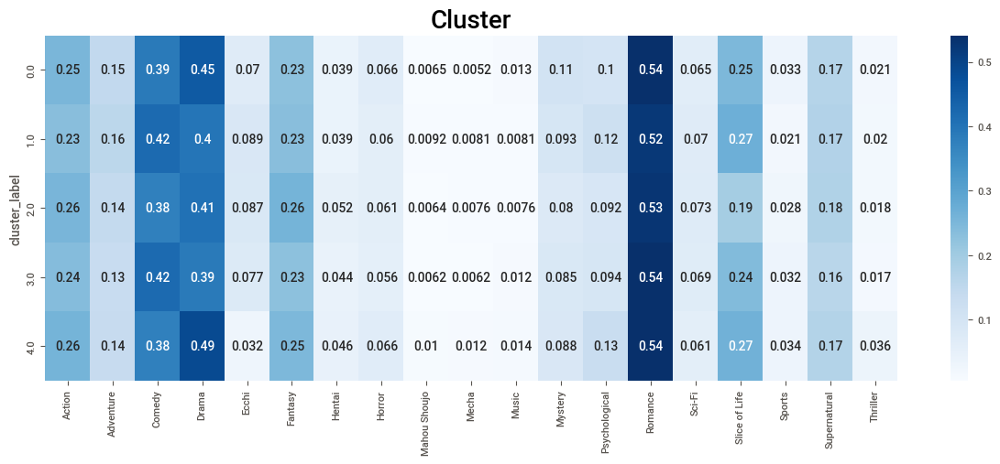

In [ ]:
# Now it is like a sparse matrix, so run truncated SVD for latent semantic analysis
sp = scipy.sparse.csr_matrix(df_tags_expanded.iloc[:, 1:-2].values)

# Try DB and CH scores again (Reminder: DB=lower the better, CH=Higher the better)
plot_db_ch_scores(sp, 10, convert_dense=True, title="Tag SVD (k=3): Davies_Bouldin and Calinski-Harabasz Scores")
km = KMeans(n_clusters=5, init="k-means++", max_iter=100, n_init=1, random_state=42).fit(sp)
km_labels = km.predict(sp)

svd = TruncatedSVD(n_components=3, random_state=42)
svd_tag = svd.fit_transform(sp)

# Add titles
title_values = df_tags_title["title_romaji"].values
title_values = np.expand_dims(title_values, axis=1)
svd_tf_idf_title = np.append(svd_tag, title_values, axis=1)

# 3D plot
fig = px.scatter_3d(
    svd_tf_idf_title, x=svd_tf_idf_title[:, 0], y=svd_tf_idf_title[:, 1], z=svd_tf_idf_title[:, 2], hover_data=[3], color=km_labels
)
fig.show()

# Check cluster ratio
df_genre = df_titles.iloc[:, 32:-7]
# df_id = df_titles.iloc[:, 0]
# df_genre = pd.concat([df_id, df_genre], axis=1)
df_tag_cluster_genre = pd.concat([df_genre, pd.DataFrame(km_labels)], axis=1)
col_list = list(df_tag_cluster_genre.columns)
col_list[-1] = "cluster_label"
df_tag_cluster_genre.columns = col_list
display(df_tag_cluster_genre.head())

# Take genre average and compare
df_cluster_avg = df_tag_cluster_genre.groupby("cluster_label").mean()
fig, ax = plt.subplots(figsize=(15,5))
plt.title("Cluster", fontdict = {"size": 20})
sns.heatmap(ax=ax, data=df_cluster_avg, annot=True, fmt=".2", cmap="Blues")
plt.show()

#### Review data: Cleaning

In [ ]:
# Clean text -> remove image tags and http etc
df_reviews["text_body_cleaned"] = df_reviews["text_body"].apply(lambda x: clean_text(x))
df_reviews["text_body_wc"] = df_reviews["text_body"].apply(lambda x: word_count(x))
df_reviews["text_body_cleaned_further"] = df_reviews["text_body_cleaned"].apply(lambda x: clean_review_img_tags(preprocess_text(x)))
df_reviews["text_body_cleaned_further_wc"] = df_reviews["text_body_cleaned_further"].apply(lambda x: word_count(x))

In [ ]:
print(df_reviews["text_body_cleaned_further"][100])
print(len(df_titles[df_titles["review_count"] > 0]))

# Concatenate all the words in text_body_cleaned_further for every title
# df_tags_expanded = df_tags.pivot("title_id", columns="tag_name")["tag_category_concat"]
df_reviews_concat = df_reviews.groupby("title_id")["text_body_cleaned_further"].sum()
df_reviews_concat_wc = df_reviews_concat.apply(lambda x: word_count(x))
df_reviews_concat_merge = pd.concat([df_reviews_concat, df_reviews_concat_wc], axis=1)
df_reviews_concat_merge.columns = ["text_body_cleaned_further", "text_body_cleaned_further_wc"]

# Merge with titles table
df_titles_reviews = pd.merge(df_titles, df_reviews_concat_merge, how="inner", on="title_id")
df_titles_reviews["synopsis_review_concat"] = df_titles_reviews["synopsis_cleaned_further"] + df_titles_reviews["text_body_cleaned_further"]
df_titles_reviews["synopsis_review_concat_wc"] = df_titles_reviews["synopsis_review_concat"].apply(lambda x: word_count(x))
# display(df_titles_reviews.head())
print(len(df_titles_reviews))

['diving', 'college', 'life', 'new', 'freshman', 'year', 'moved', 'seaside', 'town', 'ocean', 'wave', 'attend', 'moves', 'scuba', 'diving', 'shop', 'eagerly', 'anticipates', 'dream', 'college', 'life', 'filled', 'beautiful', 'girls', 'good', 'friends', 'things', 'go', 'according', 'plan', 'time', 'make', 'peaceful', 'college', 'life', 'situation', 'take', 'yet', 'another', 'dive', 'sober', 'new', 'seasonal', 'anime', 'released', 'everyone', 'talking', 'scroll', 'find', 'anime', 'coming', 'new', 'season', 'stumble', 'upon', 'anime', 'called', 'though', 'sizable', 'number', 'people', 'watching', 'still', 'pretty', 'unknown', 'anime', 'community', 'manga', 'community', 'holy', 'everyone', 'manga', 'community', 'talking', 'need', 'watch', 'wait', 'every', 'week', 'one', 'episode', 'finally', 'finished', 'picked', 'anime', 'left', 'manga', 'oh', 'boy', 'manga', 'better', 'manga', 'days', 'finally', 'got', 'catch', 'manga', 'still', 'waiting', 'new', 'chapter', 'correct', 'manga', 'hiatus', 

#### Review data: Doc2Vec

In [ ]:
review_tokenized = df_titles_reviews["synopsis_review_concat"]
titles = df_titles_reviews["title_romaji"]
tagged_data = [TaggedDocument(words=review_words, tags=[title]) for title, review_words in zip(titles, review_tokenized)]

In [ ]:
# Train model (default uncommented)
model_100_review = Doc2Vec( # typical setting that is shown in the gensim document
    vector_size=100, epochs=20, min_count=2,
    sample=0, workers=CPU_COUNT, negative=5, hs=0
)
model_100_review.build_vocab(tagged_data)

# model_300_review = Doc2Vec( # see what increasing vector dim does to the doc clusters with tSNE
#     vector_size=300, epochs=20, min_count=2,
#     sample=0, workers=CPU_COUNT, negative=5, hs=0
# )
# model_300_review.build_vocab(tagged_data)

# train doc2vec model
for epoch in range(30):
    if (epoch % 10) == 0:
        print("epoch: ", epoch)
    model_100_review.train(tagged_data, total_examples=model_100_review.corpus_count, epochs=model_100_review.iter)
    model_100_review.alpha -= 0.002
    model_100_review.min_alpha = model_100_review.alpha
    # model_300_review.train(tagged_data, total_examples=model_300_review.corpus_count, epochs=model_300_review.iter)
    # model_300_review.alpha -= 0.002
    # model_300_review.min_alpha = model_300_review.alpha

model_100_review.save("drive/MyDrive/694_Milestone II/d2v_review_5000_100.model")
# model_300.save("drive/MyDrive/694_Milestone II/d2v_review_5000_300.model")
print("Doc2Vec training finished")

epoch:  0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: DeprecationWarning:

Call to deprecated `iter` (Attribute will be removed in 4.0.0, use self.epochs instead).



epoch:  10
epoch:  20
Doc2Vec training finished


In [ ]:
# Reload model
model = Doc2Vec.load("drive/MyDrive/694_Milestone II/d2v_review_5000_100.model")
# model = Doc2Vec.load("drive/MyDrive/694_Milestone II/d2v_review_5000_300.model")

titles, rev_vec = zip(*[(doc.tags[0], model.docvecs[i]) for i, doc in enumerate(tagged_data)])
rev_vec = np.array(rev_vec)
titles = np.expand_dims(np.array(titles), axis=1)
# syn_source = np.expand_dims(np.array(df_titles["synopsis_source"]), axis=1)
# meta = np.concatenate((syn_source, titles), axis=1)
# meta_header = np.insert(meta, 0, ["Source", "Title"], axis=0)

# save for embedding projector
np.savetxt("drive/MyDrive/694_Milestone II/rev_vec_5000.tsv", rev_vec, delimiter='\t', fmt="%f")
np.savetxt("drive/MyDrive/694_Milestone II/rev_vec_meta_5000.tsv", titles, delimiter='\t', fmt="%s")

# Load data to tensorboard
writer = SummaryWriter()
writer.add_embedding(torch.FloatTensor(rev_vec), metadata=titles)
writer.close()

# # Test a few documents to see if the model is able to infer close documents
# test_text_naruto = "Twelve years before the start of the series, the Nine-Tails attacked Konohagakure destroying much of the village and taking many lives. The leader of the village, the Fourth Hokage, sacrificed his life to seal the Nine-Tails into a newborn, Naruto Uzumaki. Orphaned by the attack, Naruto was shunned by the villagers, who out of fear and anger, viewed him as the Nine-Tails itself. Though the Third Hokage outlawed speaking about anything related to the Nine-Tails, the children — taking their cues from their parents — inherited the same animosity towards Naruto. In his thirst to be acknowledged, Naruto vowed he would one day become the greatest Hokage the village had ever seen."
# test_doc = word_tokenize(test_text_naruto.lower())
# res = model.most_similar(test_doc)
# print("inferences result: ", res)


In [ ]:
# Browser becomes too heavy to handle, output will be shown on the report itself
# %reload_ext tensorboard
# %tensorboard --logdir ./runs

---
## Supervised Learning
---

### Common Functions

In [ ]:
def plot_pred_test(y_test, y_pred, ax_low, ax_high, title):
    f, (ax0) = plt.subplots(1, 1, sharey=True)
    ax0.scatter(y_test, y_pred)
    ax0.plot([ax_low, ax_high], [ax_low, ax_high], '--k')
    ax0.set_ylabel("Prediction")
    
    ax0.set_xlabel("True Value")
    ax0.set_title(title)
    ax0.text(ax_low+(ax_low*0.1), ax_high*0.9, r'$R^2$=%.5f, RMSE=%.2f' % (
        r2_score(y_test, y_pred), np.sqrt(mean_squared_error(y_test, y_pred))))
    ax0.set_xlim([ax_low, ax_high])
    ax0.set_ylim([ax_low, ax_high])

### Model Development

#### Baseline model (Linear Regression)

train length:  3253 test length:  1395


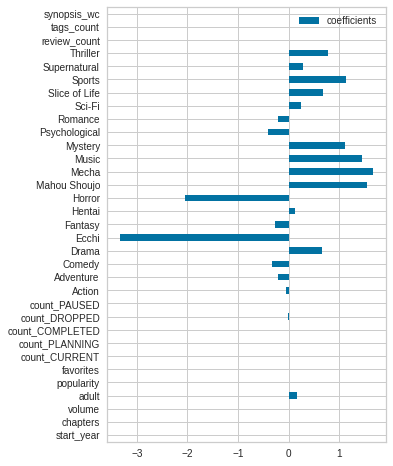

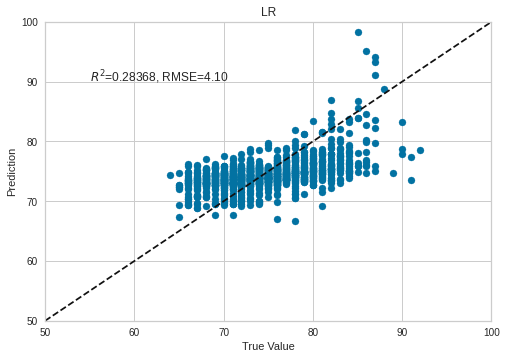

In [ ]:
# The target column for this task is "mean_score".
# This column is the mean of the rating scores that the users gave, and it is marked out of 100.
# "average_score" is a weighted average, and the API document does not provide an explanation on what kind of weighting, so we're going to avoid using this as the target label.

# # Add tag data -> Just adding them actually makes results worse, so need to run dimensionality reduction first
# tag_expand_arr = np.array(df_tags_expanded.iloc[:, 1:-1])
# pca = PCA(n_components=10, random_state=42) # explained variance ratio = 0.32 (If we want 90%, it takes us 111 features)
# pca_res = pca.fit_transform(tag_expand_arr)
# print("total explained variance ratio: ", (pca.explained_variance_ratio_).sum())
# cols = ["pca_{}".format(i) for i in range(pca_res.shape[1])]
# pca_df = pd.DataFrame(pca_res, columns=cols)
# pca_df = pd.concat([pca_df, df_tags_expanded.iloc[:, 0]], axis=1)
# df_titles_tags = pd.merge(df_titles, pca_df, how="outer", on="title_id")
# delete_cols = ["title_id", "average_score", "score_10", "score_20", "score_30", "score_40", "score_50", "score_60", "score_70", "score_80", "score_90", "score_100", "ranking_RATED", "ranking_POPULAR"]
# df_supervised = df_titles_tags.drop(delete_cols, axis=1)

# Set columns that are not going to be used as feature (Those that could act as a direct "leak" to the prediction task)
# score_10 ~ score_100 do not act as direct leak just by themselves, but could act as a leak if they are all combined, so we're avoiding them.
delete_cols = ["title_id", "average_score", "score_10", "score_20", "score_30", "score_40", "score_50", "score_60", "score_70", "score_80", "score_90", "score_100", "ranking_RATED", "ranking_POPULAR"]
df_supervised = df_titles.drop(delete_cols, axis=1) 
df_supervised = df_supervised.select_dtypes(include=["float64", "int64", "bool"])
df_supervised = df_supervised.fillna(-999) # for gbdt it would be filled with -999
X = df_supervised.drop(["mean_score"], axis=1)
Y = df_supervised["mean_score"]

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)
print("train length: ", len(X_train), "test length: ", len(X_test))

# Build a baseline model so that we can benchmark against it.
# Multivariate regression with simple penalty (L2)
# L2 because it has only a few features with high correlation
lr = LinearRegression().fit(X_train, y_train)

# Plot the feature importance (model coefficients)
# print("raw feature importance: ", lr.coef_)
df_feature_importance = pd.DataFrame(lr.coef_, X.columns, columns=["coefficients"])
df_feature_importance.plot(kind="barh", figsize=(5,8))

# Predict and evaluate
# This is regression we can use R2 to let it describe the explanation power of the model along with RMSE
y_pred = lr.predict(X_test)
plot_pred_test(y_test, y_pred, 50, 100, "LR")

#### Random Forest

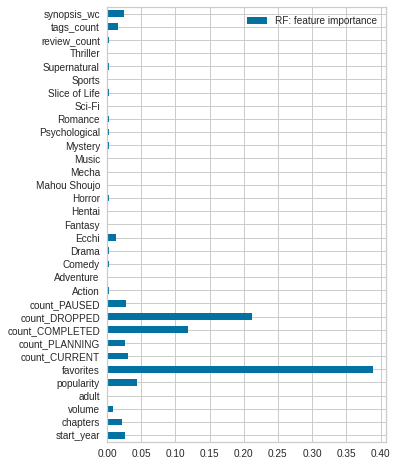

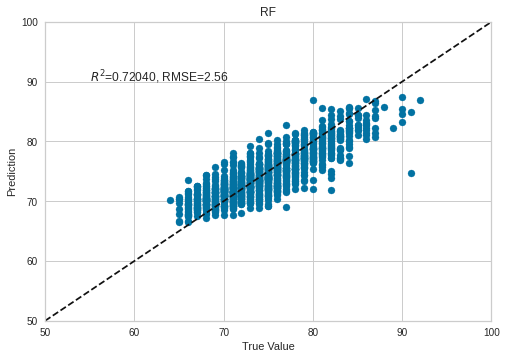

In [ ]:
# Quick trial with default RF
from yellowbrick.model_selection import learning_curve

rf = RandomForestRegressor(random_state=42).fit(X_train, y_train)
df_feature_importance = pd.DataFrame(rf.feature_importances_, X.columns, columns=["RF: feature importance"])
df_feature_importance.plot(kind="barh", figsize=(5,8))

# RF feature importance seems more logical than linear regression, but let's check r2 and RMSE
y_pred_rf = rf.predict(X_test)
plot_pred_test(y_test, y_pred_rf, 50, 100, "RF")

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:197: FutureWarning:

From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.



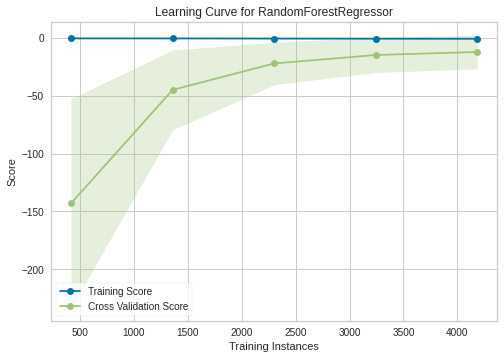

In [ ]:
# Quickly plot the learning curve with Corss Validation
# We can see that only having 1000 samples was just not enough
visualizer = learning_curve(rf, X, Y, cv=10, scoring="neg_mean_squared_error")
plt.show()

#### Gradient Boosted Decision Tree

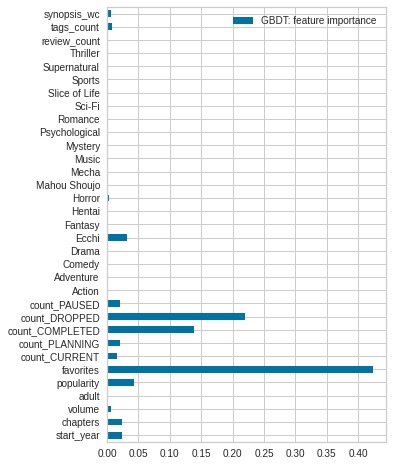

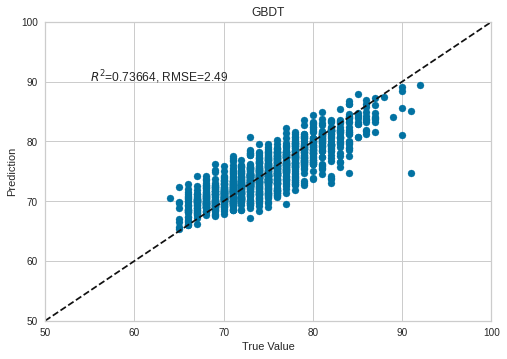

In [ ]:
# Another quick run of GradientBoostingRegressor
params = {
    "random_state":42,
    "n_estimators":300
}

gbr = GradientBoostingRegressor(**params).fit(X_train, y_train)
df_feature_importance = pd.DataFrame(gbr.feature_importances_, X.columns, columns=["GBDT: feature importance"])
df_feature_importance.plot(kind="barh", figsize=(5,8))

# Better score than RF default
y_pred_gbr = gbr.predict(X_test)
plot_pred_test(y_test, y_pred_gbr, 50, 100, "GBDT")

# Plot training errors
test_score = []
for y_pred in gbr.staged_predict(X_test):
    test_score.append(gbr.loss_(y_test, y_pred))

boost_iter=np.arange(params["n_estimators"]) 
fig = go.Figure()
fig.add_trace(go.Scatter(x=boost_iter, y=test_score, mode="lines", name="Test Loss"))
fig.add_trace(go.Scatter(x=boost_iter, y=gbr.train_score_, mode="lines", name="Train Loss"))
fig.update_layout(title="Train and Test Scores for GBDT iterations", width=800)
fig.show()


#### MLP

In [ ]:
# Define DS
class ComicDataset(Dataset):
    def __init__(self, x_data, y_data):
        self.features = x_data
        self.target = y_data

    def __len__(self):
        return len(self.features)

    def feat_width(self):
        return self.features.shape[1]

    def __getitem__(self, index):
        features = self.features.iloc[index, :]
        features_out = torch.from_numpy(features.to_numpy()).float()
        target = self.target.iloc[index, :]
        target_out = torch.from_numpy(target.to_numpy()).float()
        return features_out, target_out

df_target = df_titles[["mean_score"]]
delete_cols = ["title_id", "average_score", "mean_score", "score_10", "score_20", "score_30", "score_40", "score_50", "score_60", "score_70", "score_80", "score_90", "score_100", "ranking_RATED", "ranking_POPULAR"]
df_dataset = df_titles.drop(delete_cols, axis=1)
df_dataset["adult"] = df_dataset["adult"].astype(int)
df_dataset = df_dataset.select_dtypes(include=["float64", "int64"])
df_dataset = df_dataset.fillna(-1) # Not -999 but -1 
# For some reason if we use full data with GPU Colab shuts down its instance, so limit the data to 4000
X_train_df, X_test_df, y_train_df, y_test_df = train_test_split(df_dataset[:4000], df_target[:4000], test_size=0.3, random_state=42)

# Scale data
ss = StandardScaler()
X_train_df = pd.DataFrame(ss.fit_transform(X_train_df), columns=X_train_df.columns)
X_test_df = pd.DataFrame(ss.transform(X_test_df), columns=X_test_df.columns)
display(X_train_df.head())
display(X_test_df.head())

# Create train and test Dataset
train_ds = ComicDataset(X_train_df, y_train_df)
test_ds = ComicDataset(X_test_df, y_test_df)

one_train_ds = train_ds.__getitem__(3)
print("train ds len: ", train_ds.__len__())
print("train ds features: ", one_train_ds[0])
print("train ds target: ", one_train_ds[1])

one_test_ds = test_ds.__getitem__(10)
print("test ds len: ", test_ds.__len__())
print("test ds features: ", one_test_ds[0])
print("test ds target: ", one_test_ds[1])

print(train_ds.feat_width())
print(test_ds.feat_width())

,start_year,chapters,volume,adult,popularity,favorites,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count
0,-0.037229,2.230704,1.279304,-0.278096,-0.311722,-0.175483,-0.215153,-0.232075,-0.331793,-0.292871,-0.267479,-0.575151,-0.412407,1.207600,-0.852211,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,0.940347,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,-0.73104
1,-0.416578,0.125032,0.082134,-0.278096,-0.328748,-0.182694,-0.293737,-0.294902,-0.226138,-0.350505,-0.299320,-0.575151,2.424790,-0.828089,1.173418,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,0.940347,3.815174,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,0.40336
2,0.080499,-0.541170,-0.636167,-0.278096,2.873015,1.014272,3.605228,2.856467,-0.007631,5.717535,4.638409,1.738674,-0.412407,-0.828089,1.173418,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,-1.063437,3.815174,-0.580649,-0.174781,2.171241,-0.147979,1.091221,1.31088
3,0.119742,-0.374619,-0.636167,-0.278096,-0.372650,-0.188702,-0.303476,-0.416914,-0.216292,-0.404022,-0.363004,-0.575151,-0.412407,-0.828089,-0.852211,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,0.940347,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,-0.95792
4,0.093580,-0.338930,-0.157299,-0.278096,-0.050982,-0.151447,-0.178884,0.073410,0.032132,-0.095268,-0.119643,-0.575151,-0.412407,-0.828089,1.173418,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,2.876026,-1.063437,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,-0.05040


,start_year,chapters,volume,adult,popularity,favorites,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count
0,-0.011067,-0.112897,0.441285,-0.278096,-0.245165,-0.147842,-0.294744,-0.238449,-0.043607,-0.383438,-0.301595,-0.575151,-0.412407,-0.828089,1.173418,-0.278841,-0.556999,-0.217973,3.838012,-0.082656,-0.092981,-0.114125,3.159176,2.876026,-1.063437,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,-0.27728
1,0.054338,-0.457895,-0.396733,-0.278096,-0.295681,-0.174281,-0.274931,-0.405988,-0.068980,-0.325804,-0.294772,-0.575151,-0.412407,1.207600,1.173418,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,0.940347,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,-0.95792
2,-0.468902,0.113135,0.680719,-0.278096,-0.173683,-0.139430,-0.265192,0.123945,-0.219321,-0.305221,-0.144661,-0.575151,-0.412407,-0.828089,1.173418,-0.278841,-0.556999,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,-1.063437,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,0.63024
3,0.132823,-0.541170,-0.636167,-0.278096,0.006850,-0.138228,0.530049,-0.338153,-0.331036,0.398738,-0.021843,-0.575151,-0.412407,1.207600,-0.852211,3.586277,1.795335,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,0.940347,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,0.63024
4,0.106661,-0.541170,-0.636167,-0.278096,-0.101498,-0.168272,0.342657,-0.372753,-0.335580,0.007650,-0.087801,-0.575151,2.424790,-0.828089,-0.852211,-0.278841,1.795335,-0.217973,-0.260552,-0.082656,-0.092981,-0.114125,-0.316538,-0.347702,-1.063437,-0.262111,-0.580649,-0.174781,-0.460566,-0.147979,-0.331558,-0.50416


train ds len:  2800
train ds features:  tensor([ 0.1197, -0.3746, -0.6362, -0.2781, -0.3727, -0.1887, -0.3035, -0.4169,
        -0.2163, -0.4040, -0.3630, -0.5752, -0.4124, -0.8281, -0.8522, -0.2788,
        -0.5570, -0.2180, -0.2606, -0.0827, -0.0930, -0.1141, -0.3165, -0.3477,
         0.9403, -0.2621, -0.5806, -0.1748, -0.4606, -0.1480, -0.3316, -0.9579])
train ds target:  tensor([72.])
test ds len:  1200
test ds features:  tensor([ 0.1067, -0.2557, -0.1573, -0.2781, -0.3479, -0.1839, -0.2837, -0.3013,
        -0.2882, -0.3217, -0.2879, -0.5752, -0.4124, -0.8281,  1.1734, -0.2788,
        -0.5570, -0.2180, -0.2606, -0.0827, -0.0930, -0.1141, -0.3165, -0.3477,
         0.9403, -0.2621, -0.5806, -0.1748, -0.4606, -0.1480,  1.0912,  0.1765])
test ds target:  tensor([75.])
32
32


In [ ]:
# Create Dataloader
train_dataloader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = DataLoader(test_ds, batch_size=BATCH_SIZE, shuffle=False)

class MLP(nn.Module):
    def __init__(self, input_dim):
        super(MLP, self).__init__()
        self.hidden1 = nn.Linear(input_dim, 30)
        self.ac1 = nn.ReLU() # Tanh() gives "flat" predictions so no good, Sigmoid() gives blank plots
        self.hidden2 = nn.Linear(30, 15)
        self.ac2 = nn.ReLU()
        self.hidden3 = nn.Linear(15, 8)
        self.ac3 = nn.ReLU()
        self.hidden4 = nn.Linear(8, 1)
        self.dropout1 = nn.Dropout(0.3)
        self.dropout2 = nn.Dropout(0.3)
        self.dropout3 = nn.Dropout(0.3)
        self.init_weights()

    def init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_uniform_(m.weight)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def forward(self, X):
        X = self.ac1(self.dropout1(self.hidden1(X)))
        X = self.ac2(self.dropout2(self.hidden2(X)))
        X = self.ac3(self.dropout3(self.hidden3(X)))
        X = self.hidden4(X)
        return X

def train_and_validate(model, train_dl, test_dl):
    writer = SummaryWriter()
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.005)
    # optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9, weight_decay=0.001)
    # scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.1, patience=100, verbose=True)
    # scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=100, gamma=0.1, verbose=True)
    for epoch in range(500):
        if (epoch % 100) == 0:
            print("epoch: ", epoch)
        for i, ((features, targets), (test_features, test_targets)) in enumerate(zip(train_dl, test_dl)):
            model.train()
            optimizer.zero_grad() # clear gradients at the start of batch
            output = model(features.to(device))
            loss = criterion(output, targets.to(device)) # calculate loss between y_pred ad y_true
            loss = loss.to(device)
            loss.backward() # backprop
            optimizer.step() # renew model weights
            with torch.no_grad():
                model.eval() # switch the model to inference mode
                y_pred = model(test_features.to(device))
                y_pred = y_pred.detach().cpu().numpy()
                y_test = test_targets.detach().cpu().numpy()
                test_mse = mean_squared_error(y_test, y_pred)
                writer.add_scalars("Loss", {"train loss": loss.cpu().numpy(), "test loss" : test_mse}, epoch)
        # scheduler.step()
    writer.flush()

def evaluate(model, data_loader):
    model.eval()
    with torch.no_grad():
        y_preds, y_tests = [], []
        for features, targets in data_loader:
            y_pred = model(features.to(device))
            y_pred = y_pred.detach().cpu().numpy()
            y_preds.append(y_pred)
            y_test = targets.cpu().numpy()
            y_tests.append(y_test)
        y_preds, y_tests = np.vstack(y_preds), np.vstack(y_tests)
        return y_preds, y_tests

In [ ]:
# Train model and write the losses to tensorboard
# Training time:
# 2000 samples, GPU -> 6min
# 3000 samples, GPU -> 545sec (9min)
# 4000 samples, GPU -> 716sec (12min)

mlp = MLP(train_ds.feat_width())
mlp.to(device)
start = time.time()
train_and_validate(mlp, train_dataloader, test_dataloader)
print("train finished with: ", time.time() - start)

epoch:  0
epoch:  100
epoch:  200
epoch:  300
epoch:  400
train finished with:  716.477789402008


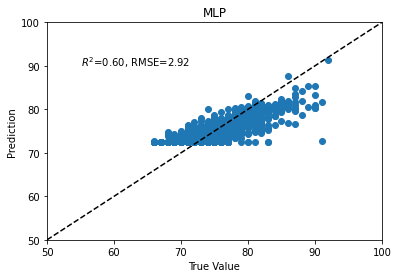

In [ ]:
# Overall evaluation of the predictions made
y_preds, y_tests = evaluate(mlp, test_dataloader)
plot_pred_test(y_tests, y_preds, 50, 100, "MLP")

In [ ]:
# Please "toggle all runs" first, then choose the last two runs as they are the train and test plots
%reload_ext tensorboard
%tensorboard --logdir ./runs

<IPython.core.display.Javascript object>

### Improving Model Accuracy

#### Data Transformation

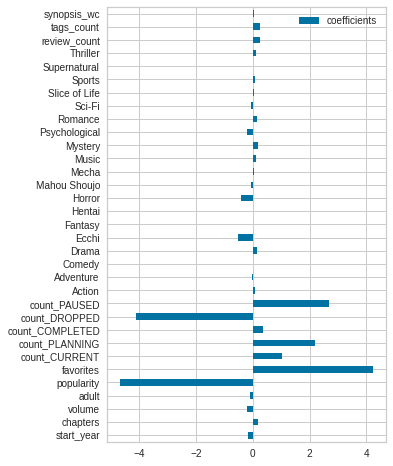

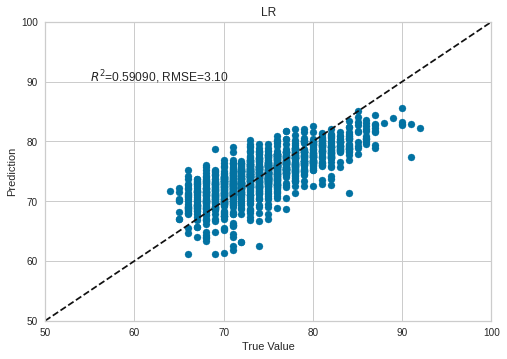

In [ ]:
# Data transformation like log, box-cox, yeo-johnson only works with models that assumes gaussian distribution of the inpur variables, 
# but we'll see how it might change the output of decision tree based models as well.

# PowerTransform with yeo-johnson to see if it improves the results
X = df_supervised.drop(["mean_score"], axis=1)
Y = df_supervised["mean_score"]

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# Fit with train data and transform test data
pt = PowerTransformer(method="yeo-johnson")
X_train = pt.fit_transform(X_train)
X_test = pt.transform(X_test)

# Run the exact same process
lr = LinearRegression().fit(X_train, y_train)
df_feature_importance = pd.DataFrame(lr.coef_, X.columns, columns=["coefficients"])
df_feature_importance.plot(kind="barh", figsize=(5,8))
y_pred_lr_pt = lr.predict(X_test)
plot_pred_test(y_test, y_pred_lr_pt, 50, 100, "LR")

# # Just to check if it has any effect on RF and GBDT: It has no effect as expected
# # RF
# rf = RandomForestRegressor(random_state=42).fit(X_train, y_train)
# df_feature_importance = pd.DataFrame(rf.feature_importances_, X.columns, columns=["RF: feature importance"])
# df_feature_importance.plot(kind="barh", figsize=(5,8))
# y_pred = rf.predict(X_test)
# plot_pred_test(y_test, y_pred, 50, 100, "RF")

# # GBDT
# gbr = GradientBoostingRegressor(random_state=42).fit(X_train, y_train)
# df_feature_importance = pd.DataFrame(gbr.feature_importances_, X.columns, columns=["GBDT: feature importance"])
# df_feature_importance.plot(kind="barh", figsize=(5,8))
# y_pred = gbr.predict(X_test)
# print(y_test.shape)
# print(y_pred.shape)
# plot_pred_test(y_test, y_pred, 50, 100, "GBDT")

#### Feature Engineering

(4648, 100)
train length:  3266 test length:  1400


,start_year,chapters,volume,popularity,favorites,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count,synopsis_wc,w2v_nn_pca_1,w2v_nn_pca_2,w2v_nn_pca_3,w2v_nn_pca_4,w2v_nn_pca_5
4526,2010.0,47.0,10.0,936.0,7.0,212.0,430.0,132.0,60.0,102.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,-999.0,3.0,348.0,-39.370635,-0.791168,-1.068274,1.563984,0.333995
420,2018.0,9.0,3.0,1497.0,73.0,209.0,964.0,281.0,8.0,35.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,7.0,310.0,-40.649327,0.883701,1.976314,-1.247711,1.713077
3002,1975.0,4.0,1.0,809.0,11.0,18.0,382.0,393.0,9.0,7.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,-999.0,7.0,312.0,-39.743623,-0.484568,-1.372060,-0.078660,0.376859
6,2005.0,-999.0,-999.0,51935.0,7119.0,23753.0,21470.0,1749.0,689.0,4274.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,27.0,368.0,-39.563055,0.090386,-0.565178,-0.508026,0.869595
932,2021.0,-999.0,-999.0,1533.0,40.0,1177.0,279.0,7.0,23.0,47.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-999.0,8.0,464.0,-39.681217,0.978589,-0.390338,-0.944578,-1.390775


,start_year,chapters,volume,popularity,favorites,count_CURRENT,count_PLANNING,count_COMPLETED,count_DROPPED,count_PAUSED,Action,Adventure,Comedy,Drama,Ecchi,Fantasy,Hentai,Horror,Mahou Shoujo,Mecha,Music,Mystery,Psychological,Romance,Sci-Fi,Slice of Life,Sports,Supernatural,Thriller,review_count,tags_count,synopsis_wc,w2v_nn_pca_1,w2v_nn_pca_2,w2v_nn_pca_3,w2v_nn_pca_4,w2v_nn_pca_5
3307,2020.0,-999.0,-999.0,1220.0,35.0,752.0,323.0,7.0,48.0,90.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,6.0,550.0,-39.370455,-0.382573,-0.549106,-0.857771,-0.000820
2699,2019.0,10.0,1.0,1202.0,35.0,100.0,385.0,695.0,10.0,12.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,-999.0,8.0,484.0,-40.406486,0.851279,1.237996,-0.553113,-0.052202
3423,2011.0,18.0,2.0,581.0,6.0,21.0,219.0,324.0,7.0,10.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,-999.0,8.0,302.0,-39.555625,-1.023374,0.618934,0.703580,-0.274068
23,2012.0,42.0,9.0,2536.0,402.0,147.0,1221.0,1122.0,20.0,26.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,18.0,381.0,-39.792906,-0.501292,-0.383910,0.088898,0.033227
1175,1999.0,382.0,42.0,3128.0,80.0,261.0,971.0,1522.0,165.0,209.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,-999.0,6.0,694.0,-39.827913,-0.999488,-0.541976,0.636618,-1.583151


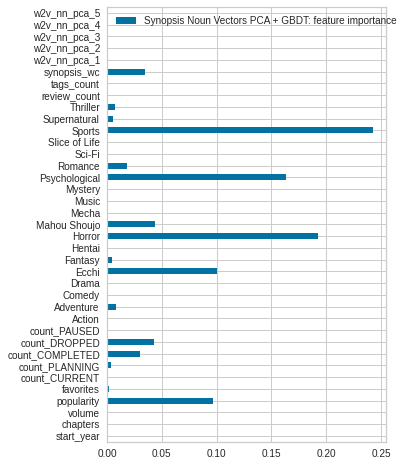

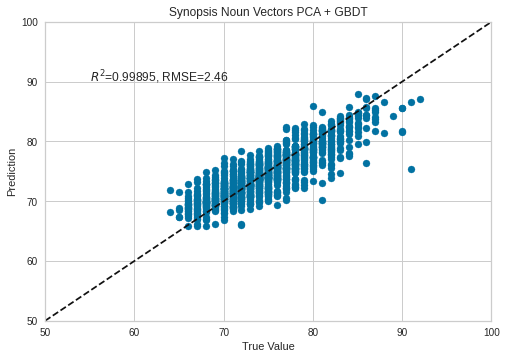

In [ ]:
# Add PCA components of word2vec noun vectors to the X to see if it improves

# Replace empty vectors
nn_vec = np.array(df_titles["syn_pos_avg_nn"])
for i, e in enumerate(nn_vec):
    if e.shape != (100,):
        # print(i) # there were 10 empty vectors
        nn_vec[i] = np.zeros(100,)
nn_vec = np.vstack(nn_vec)
print(nn_vec.shape)

# Convert w2v values to df so it can be concatenated
df_nn_vec = pd.DataFrame(nn_vec)

# Filter data as usual, and then concatenate the w2v df
delete_cols = ["title_id", "average_score", "score_10", "score_20", "score_30", "score_40", "score_50", "score_60", "score_70", "score_80", "score_90", "score_100", "ranking_RATED", "ranking_POPULAR"]
df_supervised = df_titles.drop(delete_cols, axis=1)
df_supervised = pd.concat([df_supervised, df_nn_vec], axis=1)
df_supervised = df_supervised.select_dtypes(include=["float64", "int64", "bool"])
df_supervised = df_supervised.fillna(-999) # for gbdt it would be filled with -999
X = df_supervised.drop(["mean_score"], axis=1)
Y = df_supervised["mean_score"]

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)
print("train length: ", len(X_train), "test length: ", len(X_test))

# Run PCA on the w2v columns and make them into df so we can concatenate them after
pca_nn = PCA(n_components=5, random_state=42)
X_train_nn_pca = pca_nn.fit_transform(X_train.iloc[:, 32:])
X_test_nn_pca = pca_nn.transform(X_test.iloc[:, 32:])

cols = ["w2v_nn_pca_%s"%i for i in range(1,6)]
X_train_nn_pca = pd.DataFrame(X_train_nn_pca, columns=cols, index=X_train.index)
X_test_nn_pca = pd.DataFrame(X_test_nn_pca, columns=cols, index=X_test.index)
X_train = pd.concat([X_train.iloc[:, :32], X_train_nn_pca], axis=1)
X_test = pd.concat([X_test.iloc[:, :32], X_test_nn_pca], axis=1)
display(X_train.head())
display(X_test.head())

# Set params
params = {
    "random_state":42,
    "n_estimators":330
}

# Fit model
gbr_fe = GradientBoostingRegressor(**params).fit(X_train, y_train)
df_feature_importance = pd.DataFrame(gbr_fe.feature_importances_, X_train.columns, columns=["Synopsis Noun Vectors PCA + GBDT: feature importance"])
df_feature_importance.plot(kind="barh", figsize=(5,8))

# Better score than RF default
y_pred_gbr_fe = gbr_fe.predict(X_test)
plot_pred_test(y_test, y_pred_gbr_fe, 50, 100, "Synopsis Noun Vectors PCA + GBDT")

# Plot training errors
test_score = []
for y_pred in gbr_fe.staged_predict(X_test):
    test_score.append(gbr_fe.loss_(y_test, y_pred))

boost_iter=np.arange(params["n_estimators"]) 
fig = go.Figure()
fig.add_trace(go.Scatter(x=boost_iter, y=test_score, mode="lines", name="Test Loss"))
fig.add_trace(go.Scatter(x=boost_iter, y=gbr_fe.train_score_, mode="lines", name="Train Loss"))
fig.update_layout(yaxis_range=[0, 100], title="Train and Test Scores for Synopsis Noun Vectors PCA + GBDT iterations", width=800)
fig.show()

#### Ensemble

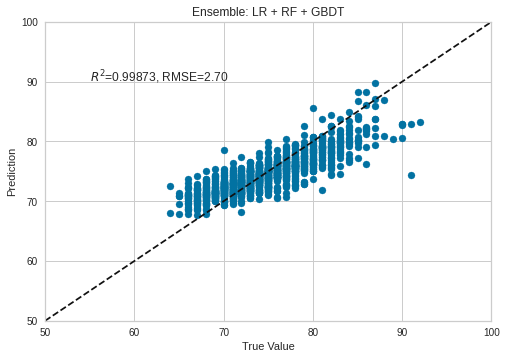

In [ ]:
# Simple averaging

# Use the same X_train and X_test from feature engineering section
lr_ens = LinearRegression().fit(X_train, y_train)
rf_ens = RandomForestRegressor(random_state=42).fit(X_train, y_train)
gbr_ens = GradientBoostingRegressor(random_state=42, n_estimators=330).fit(X_train, y_train)
y_pred_ens_lr = lr_ens.predict(X_test)
y_pred_ens_rf = rf_ens.predict(X_test)
y_pred_ens_gbr = gbr_ens.predict(X_test)

# Better score than RF default
y_pred_ens = (y_pred_ens_lr + y_pred_ens_rf + y_pred_ens_gbr) / 3
plot_pred_test(y_test, y_pred_ens, 50, 100, "Ensemble: LR + RF + GBDT")
